In [1]:
import pandas as pd
import numpy as np
from statsmodels.tsa.vector_ar.var_model import VAR
from statsmodels.tsa.stattools import grangercausalitytests
import matplotlib.pyplot as plt
import seaborn as sns

In [2]:
# load processed data
data = pd.read_csv('ProcessedData.csv')

# make Date the index
data['Date'] = pd.to_datetime(data['Date'])
data.set_index('Date', inplace=True)

In [3]:
# for now we will only use VIX Close, WTI Spot Price, IT Adj Close_Return, HC Adj Close_Return AND CD Adj Close_Return, IT Volume, HD Volume, CD Volume
data = data[['VIX Close', 'WTI Log Daily Change', 'IT_Log_Return', 'HC_Log_Return', 'CD_Log_Return', 'IT Volume', 'HC Volume', 'CD Volume']]
# rename VIX Close to VIX, IT Adj Close_Return to IT Daily Return, HC Adj Close_Return to HC Daily Return, CD Adj Close_Return to CD Daily Return
data.rename(columns={'VIX Close': 'VIX'})#, 'IT_Log_Return': 'IT Daily Return', 'HC Adj Close_Return': 'HC Daily Return', 'CD Adj Close_Return': 'CD Daily Return'}, inplace=True)

,VIX,WTI Log Daily Change,IT_Log_Return,HC_Log_Return,CD_Log_Return,IT Volume,HC Volume,CD Volume
Date,,,,,,,,
1993-05-05,12.38,0.002937,0.008621,0.008757,-0.002610,0,0,0
1993-05-06,13.22,0.001465,-0.006131,-0.013274,-0.003120,0,0,0
1993-05-07,13.01,-0.002933,0.008729,-0.004760,-0.000605,0,0,0
1993-05-10,13.72,-0.000490,-0.000779,0.001220,0.005332,0,0,0
1993-05-11,13.35,-0.001961,-0.006381,0.002877,0.002706,0,0,0
...,...,...,...,...,...,...,...,...
2025-04-22,30.57,0.017490,0.024226,0.017848,0.031825,806867100,223050800,472384400
2025-04-23,28.45,-0.030810,0.028758,0.005340,0.027267,978415600,280000500,591385400
2025-04-24,26.47,0.014423,0.034781,0.012289,0.022318,938353200,254195200,431896300


In [4]:
# remame HC Daily Return to Health Care Daily Return, CD Daaily Return to Consumer Discretionary Daily Return, IT Daily Return to Information Technology Daily Return
data.rename(columns={'HC_Log_Return': 'Health Care Daily Log Return', 'CD_Log_Return': 'Consumer Discretionary Daily Log Return', 'IT_Log_Return': 'Information Technology Daily Log Return'}, inplace=True)

In [5]:
data

,VIX Close,WTI Log Daily Change,Information Technology Daily Log Return,Health Care Daily Log Return,Consumer Discretionary Daily Log Return,IT Volume,HC Volume,CD Volume
Date,,,,,,,,
1993-05-05,12.38,0.002937,0.008621,0.008757,-0.002610,0,0,0
1993-05-06,13.22,0.001465,-0.006131,-0.013274,-0.003120,0,0,0
1993-05-07,13.01,-0.002933,0.008729,-0.004760,-0.000605,0,0,0
1993-05-10,13.72,-0.000490,-0.000779,0.001220,0.005332,0,0,0
1993-05-11,13.35,-0.001961,-0.006381,0.002877,0.002706,0,0,0
...,...,...,...,...,...,...,...,...
2025-04-22,30.57,0.017490,0.024226,0.017848,0.031825,806867100,223050800,472384400
2025-04-23,28.45,-0.030810,0.028758,0.005340,0.027267,978415600,280000500,591385400
2025-04-24,26.47,0.014423,0.034781,0.012289,0.022318,938353200,254195200,431896300


Model Selection Criteria

In [7]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from statsmodels.tsa.api import VAR

# Configuration
rolling_window = 252  # ≈ 1 year
max_lag = 6
sectors = [
    'Information Technology Daily Log Return',
    'Health Care Daily Log Return',
    'Consumer Discretionary Daily Log Return'
]
causing_vars = ['WTI Log Daily Change', 'VIX Close']

# Containers for results
rolling_dates = []
joint_pvals = {sector: [] for sector in sectors}
oil_pvals = {sector: [] for sector in sectors}
vix_pvals = {sector: [] for sector in sectors}

# Rolling window Granger causality
for start in range(len(data) - rolling_window):
    end = start + rolling_window
    window_data = data.iloc[start:end].dropna()
    rolling_dates.append(data.index[end])  # store the end date

    for sector in sectors:
        try:
            temp_data = window_data[causing_vars + [sector]].copy()
            model = VAR(temp_data)
            fitted = model.fit(maxlags=max_lag, ic='aic')

            # Joint test
            joint = fitted.test_causality(causing=causing_vars, caused=sector, kind='f').pvalue
            # Individual tests
            oil_only = fitted.test_causality(causing=['WTI Log Daily Change'], caused=sector, kind='f').pvalue
            vix_only = fitted.test_causality(causing=['VIX Close'], caused=sector, kind='f').pvalue

        except Exception as e:
            joint, oil_only, vix_only = np.nan, np.nan, np.nan

        joint_pvals[sector].append(joint)
        oil_pvals[sector].append(oil_only)
        vix_pvals[sector].append(vix_only)

# Convert to DataFrames
joint_df = pd.DataFrame(joint_pvals, index=rolling_dates)
oil_df = pd.DataFrame(oil_pvals, index=rolling_dates)
vix_df = pd.DataFrame(vix_pvals, index=rolling_dates)


C:\Users\nicol\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.10_qbz5n2kfra8p0\LocalCache\local-packages\Python310\site-packages\statsmodels\tsa\base\tsa_model.py:471: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
C:\Users\nicol\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.10_qbz5n2kfra8p0\LocalCache\local-packages\Python310\site-packages\statsmodels\tsa\base\tsa_model.py:471: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
C:\Users\nicol\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.10_qbz5n2kfra8p0\LocalCache\local-packages\Python310\site-packages\statsmodels\tsa\base\tsa_model.py:471: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g

First the overall joint Granger-Causality significance

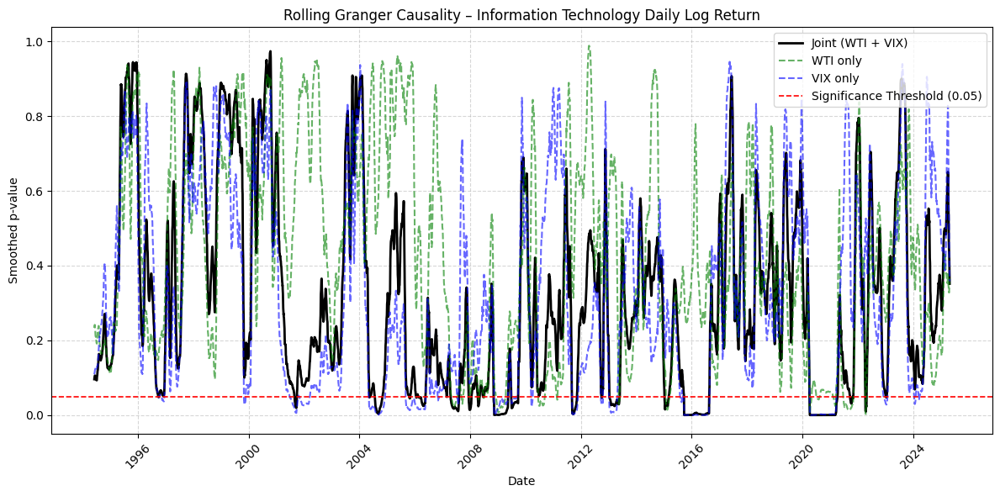

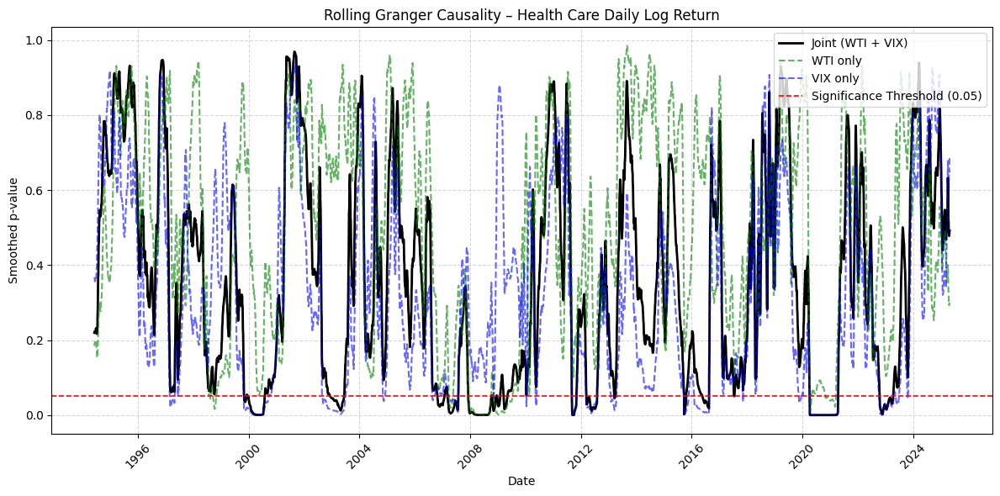

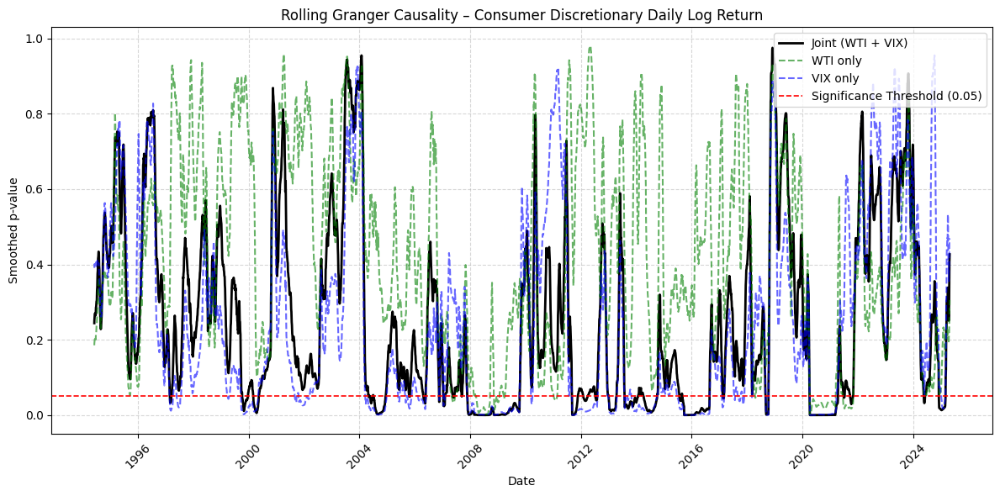

In [8]:
for sector in sectors:
    plt.figure(figsize=(12, 6))

    # Smooth
    joint_smoothed = joint_df[sector].rolling(20).mean()
    oil_smoothed = oil_df[sector].rolling(20).mean()
    vix_smoothed = vix_df[sector].rolling(20).mean()

    # Plot
    plt.plot(joint_df.index, joint_smoothed, color="black", label="Joint (WTI + VIX)", linewidth=2.0)
    plt.plot(oil_df.index, oil_smoothed, color="green", linestyle='--', alpha=0.6, label="WTI only", linewidth=1.5)
    plt.plot(vix_df.index, vix_smoothed, color="blue", linestyle='--', alpha=0.6, label="VIX only", linewidth=1.5)

    plt.axhline(y=0.05, color='red', linestyle='--', linewidth=1.2, label="Significance Threshold (0.05)")
    plt.title(f"Rolling Granger Causality – {sector}")
    plt.ylabel("Smoothed p-value")
    plt.xlabel("Date")
    # legend topright
    plt.legend(loc="upper right")
    plt.grid(True, linestyle="--", alpha=0.5)
    plt.xticks(rotation=45)
    plt.tight_layout()
    plt.show()


Decreasing Window Size for Crisis-Zoom in to better isolate immediate effects and dynamics

In [9]:
import pandas as pd
import numpy as np
from statsmodels.tsa.api import VAR
import matplotlib.pyplot as plt

# === SETTINGS ===
window_sizes = [252, 63, 21]     # Rolling windows (in trading days)
max_lag = 6                      # VAR lag length
sectors = [
    'Information Technology Daily Log Return',
    'Health Care Daily Log Return',
    'Consumer Discretionary Daily Log Return'
]

# === Ensure datetime index ===
data.index = pd.to_datetime(data.index)

# === Initialize storage dictionaries ===
rolling_joint_pvals = {}
rolling_oil_pvals = {}
rolling_vix_pvals = {}

# === MAIN LOOP ===
for window_size in window_sizes:
    print(f"Computing rolling Granger causality with window = {window_size}...")

    joint_pvals = {sector: [] for sector in sectors}
    oil_pvals = {sector: [] for sector in sectors}
    vix_pvals = {sector: [] for sector in sectors}
    rolling_dates = []

    for start in range(len(data) - window_size):
        end = start + window_size
        rolling_dates.append(data.index[end])
        window_data = data.iloc[start:end]

        for sector in sectors:
            try:
                temp_data = window_data[['WTI Log Daily Change', 'VIX Close', sector]].dropna()
                model = VAR(temp_data)
                fitted = model.fit(maxlags=max_lag, ic='aic')

                # Joint test: WTI + VIX
                joint_test = fitted.test_causality(causing=['WTI Log Daily Change', 'VIX Close'], caused=sector, kind='f')
                joint_pvals[sector].append(joint_test.pvalue)

                # WTI only (controlling for VIX)
                oil_test = fitted.test_causality(causing='WTI Log Daily Change', caused=sector, kind='f')
                oil_pvals[sector].append(oil_test.pvalue)

                # VIX only (controlling for WTI)
                vix_test = fitted.test_causality(causing='VIX Close', caused=sector, kind='f')
                vix_pvals[sector].append(vix_test.pvalue)

            except Exception as e:
                joint_pvals[sector].append(np.nan)
                oil_pvals[sector].append(np.nan)
                vix_pvals[sector].append(np.nan)

    # Convert to DataFrames
    rolling_joint_pvals[window_size] = pd.DataFrame(joint_pvals, index=rolling_dates)
    rolling_oil_pvals[window_size] = pd.DataFrame(oil_pvals, index=rolling_dates)
    rolling_vix_pvals[window_size] = pd.DataFrame(vix_pvals, index=rolling_dates)

print("✅ Finished computing all rolling Granger causality p-values.")


Computing rolling Granger causality with window = 252...


C:\Users\nicol\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.10_qbz5n2kfra8p0\LocalCache\local-packages\Python310\site-packages\statsmodels\tsa\base\tsa_model.py:471: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
C:\Users\nicol\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.10_qbz5n2kfra8p0\LocalCache\local-packages\Python310\site-packages\statsmodels\tsa\base\tsa_model.py:471: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
C:\Users\nicol\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.10_qbz5n2kfra8p0\LocalCache\local-packages\Python310\site-packages\statsmodels\tsa\base\tsa_model.py:471: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g

Computing rolling Granger causality with window = 63...


C:\Users\nicol\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.10_qbz5n2kfra8p0\LocalCache\local-packages\Python310\site-packages\statsmodels\tsa\base\tsa_model.py:471: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
C:\Users\nicol\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.10_qbz5n2kfra8p0\LocalCache\local-packages\Python310\site-packages\statsmodels\tsa\base\tsa_model.py:471: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
C:\Users\nicol\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.10_qbz5n2kfra8p0\LocalCache\local-packages\Python310\site-packages\statsmodels\tsa\base\tsa_model.py:471: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g

Computing rolling Granger causality with window = 21...


C:\Users\nicol\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.10_qbz5n2kfra8p0\LocalCache\local-packages\Python310\site-packages\statsmodels\tsa\base\tsa_model.py:471: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
C:\Users\nicol\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.10_qbz5n2kfra8p0\LocalCache\local-packages\Python310\site-packages\statsmodels\tsa\base\tsa_model.py:471: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
C:\Users\nicol\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.10_qbz5n2kfra8p0\LocalCache\local-packages\Python310\site-packages\statsmodels\tsa\base\tsa_model.py:471: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g

✅ Finished computing all rolling Granger causality p-values.


C:\Users\nicol\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.10_qbz5n2kfra8p0\LocalCache\local-packages\Python310\site-packages\statsmodels\tsa\base\tsa_model.py:471: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
C:\Users\nicol\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.10_qbz5n2kfra8p0\LocalCache\local-packages\Python310\site-packages\statsmodels\tsa\base\tsa_model.py:471: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
C:\Users\nicol\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.10_qbz5n2kfra8p0\LocalCache\local-packages\Python310\site-packages\statsmodels\tsa\base\tsa_model.py:471: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g

In [34]:
def plot_rolling_gc_windows(sector, rolling_pvals_dict, window_sizes=[252, 63, 21]):
    plt.figure(figsize=(14, 6))
    colors = {252: 'black', 63: 'blue', 21: 'green'}
    
    for window in window_sizes:
        if window in rolling_pvals_dict:
            df = rolling_pvals_dict[window]
            if sector in df.columns:
                smoothed = df[sector].rolling(20, min_periods=1).mean()
                plt.plot(df.index, smoothed,
                         label=f'{window}-day window', linewidth=2, color=colors[window])

    plt.axhline(0.05, color='red', linestyle='--', linewidth=1.2, label='Significance Threshold (0.05)')
    plt.title(f'Rolling Granger Causality Comparison – {sector}', fontsize=14)
    plt.ylabel('Smoothed p-value')
    plt.xlabel('Date')
    plt.legend()
    plt.grid(True, linestyle='--', alpha=0.5)
    plt.xticks(rotation=45)
    plt.tight_layout()
    plt.show()


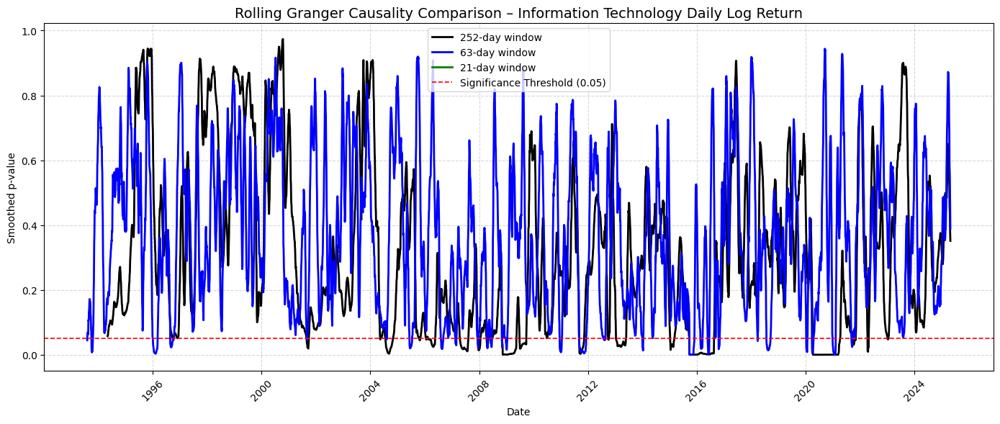

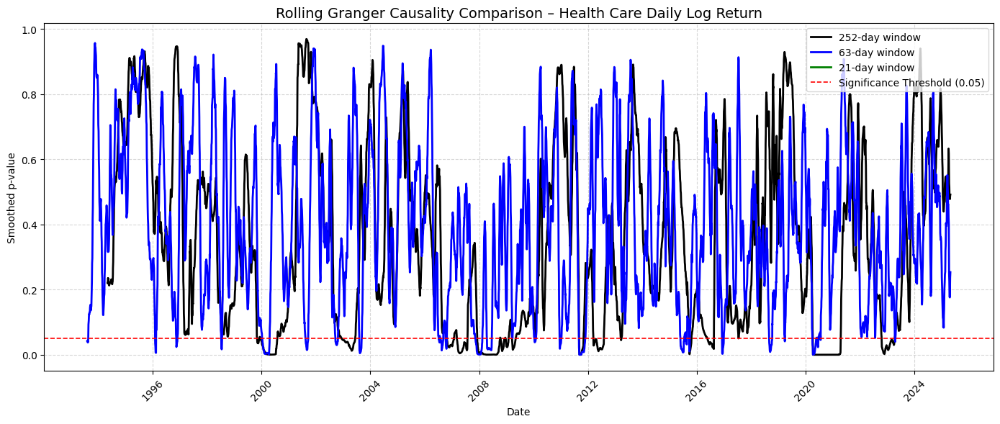

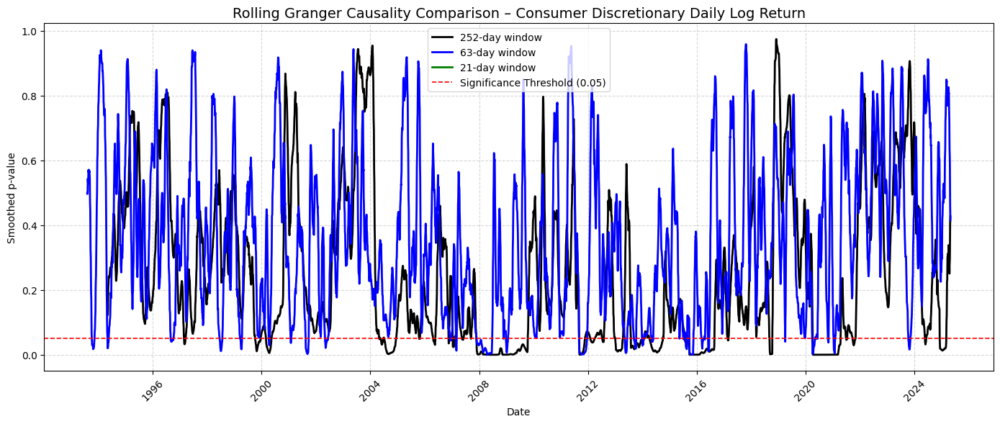

In [35]:
for sector in sectors:
    plot_rolling_gc_windows(sector, rolling_pvals_dict)


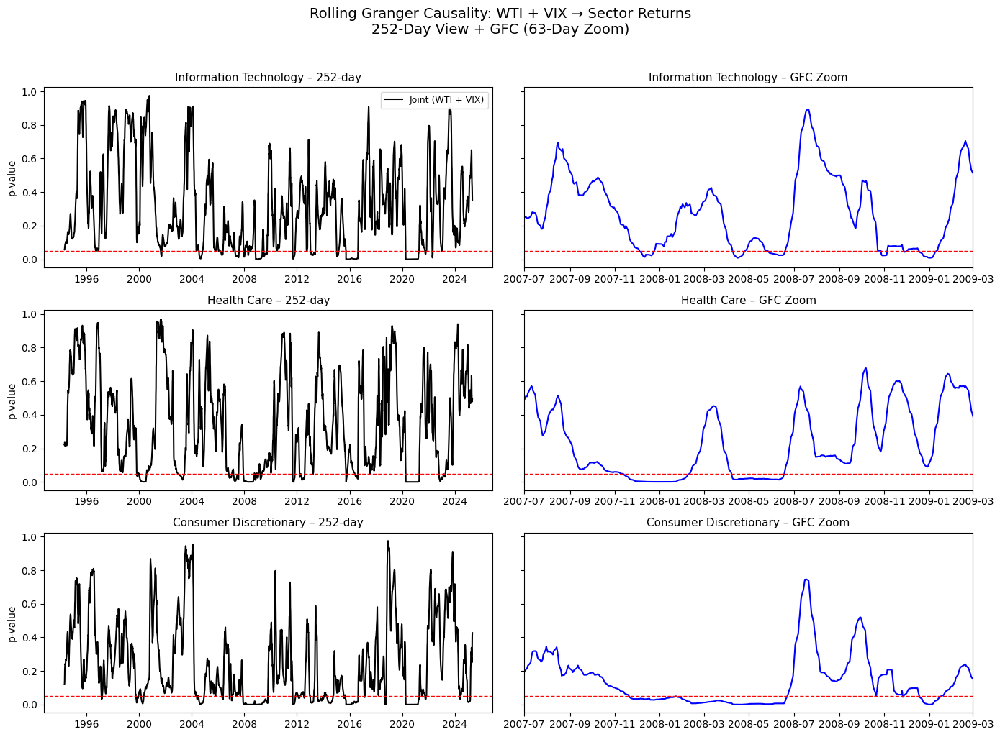

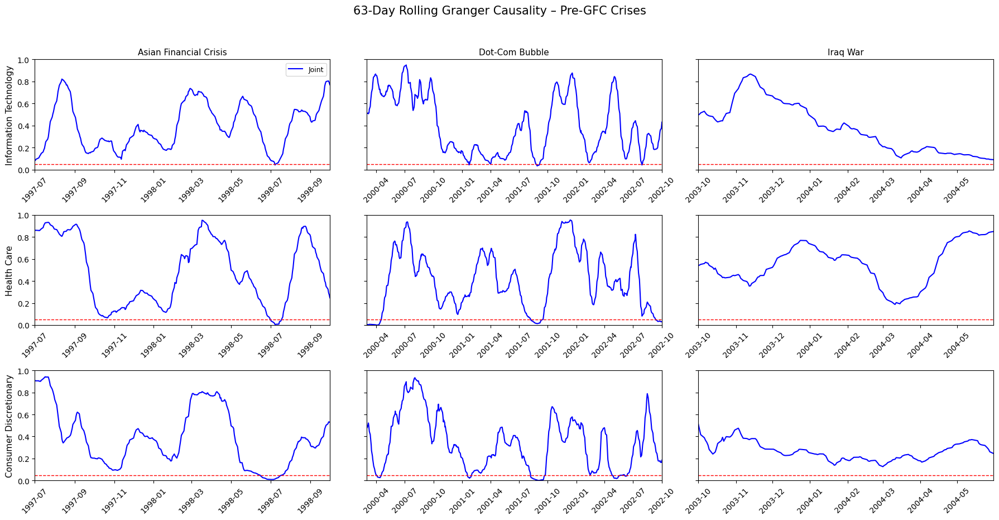

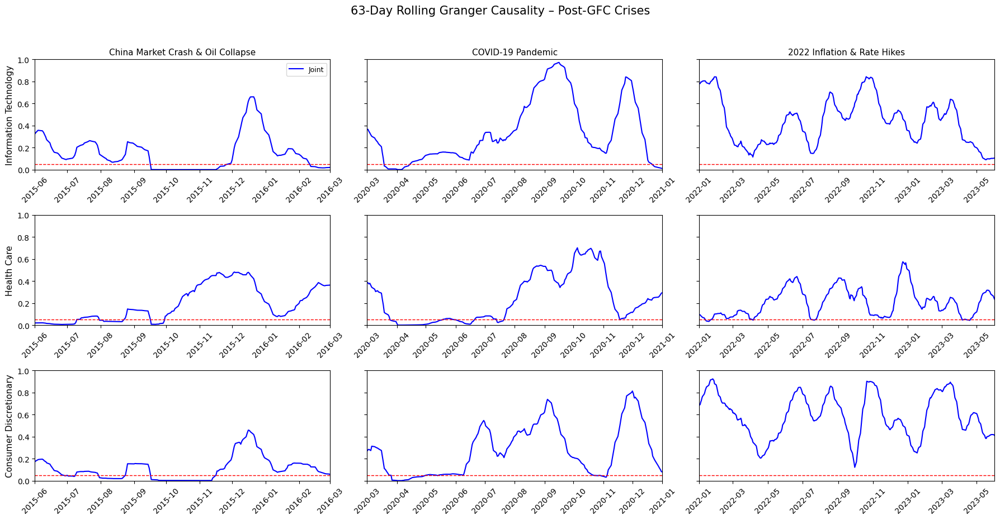

In [10]:
import matplotlib.pyplot as plt
import matplotlib.dates as mdates
import pandas as pd

# === Required Inputs ===
# Make sure `rolling_pvals_dict` is already computed with keys 252 and 63

# === Crisis windows ===
crisis_windows = [
    ("Asian Financial Crisis", "1997-07-01", "1998-10-01"),
    ("Dot-Com Bubble", "2000-03-01", "2002-10-01"),
    ("Iraq War", "2003-10-01", "2004-05-31"),
    ("Global Financial Crisis", "2007-07-01", "2009-03-01"),
    ("China Market Crash & Oil Collapse", "2015-06-01", "2016-03-01"),
    ("COVID-19 Pandemic", "2020-03-01", "2021-01-01"),
    ("2022 Inflation & Rate Hikes", "2022-01-01", "2023-06-01")
]

sectors = [
    'Information Technology Daily Log Return',
    'Health Care Daily Log Return',
    'Consumer Discretionary Daily Log Return'
]

# === Figure 1: 252-day full view + GFC zoom (63-day) ===
def plot_main_grid_gfc(rolling_pvals_dict, rolling_oil_pvals, rolling_vix_pvals, sectors):
    fig, axes = plt.subplots(len(sectors), 2, figsize=(14, 10), sharey=True)
    fig.subplots_adjust(hspace=0.4, wspace=0.25)
    crisis_start, crisis_end = pd.to_datetime("2007-07-01"), pd.to_datetime("2009-03-01")

    for i, sector in enumerate(sectors):
        # Full 252-day view
        ax = axes[i, 0]
        smoothed_joint = rolling_pvals_dict[252][sector].rolling(20, min_periods=1).mean()
        smoothed_wti = rolling_oil_pvals[252][sector].rolling(20, min_periods=1).mean()
        smoothed_vix = rolling_vix_pvals[252][sector].rolling(20, min_periods=1).mean()

        ax.plot(smoothed_joint.index, smoothed_joint, label="Joint (WTI + VIX)", color='black')
        #ax.plot(smoothed_wti.index, smoothed_wti, label="WTI Only", color='green', alpha=0.3)
        #ax.plot(smoothed_vix.index, smoothed_vix, label="VIX Only", color='blue', alpha=0.3)
        ax.axhline(0.05, color='red', linestyle='--', linewidth=1)
        ax.set_title(f"{sector.replace(' Daily Log Return','')} – 252-day", fontsize=11)
        ax.set_ylabel("p-value")
        ax.grid(False)

        # GFC Zoom with 63-day window
        ax = axes[i, 1]
        smoothed_joint = rolling_pvals_dict[63][sector].rolling(15, min_periods=1).mean()
        smoothed_wti = rolling_oil_pvals[63][sector].rolling(15, min_periods=1).mean()
        smoothed_vix = rolling_vix_pvals[63][sector].rolling(15, min_periods=1).mean()

        ax.plot(smoothed_joint.index, smoothed_joint, label="Joint (WTI + VIX)", color='blue')
        #ax.plot(smoothed_wti.index, smoothed_wti, label="WTI Only", color='green', alpha=0.3)
        #ax.plot(smoothed_vix.index, smoothed_vix, label="VIX Only", color='blue', alpha=0.3)
        ax.axhline(0.05, color='red', linestyle='--', linewidth=1)
        ax.set_xlim(crisis_start, crisis_end)
        ax.set_title(f"{sector.replace(' Daily Log Return','')} – GFC Zoom", fontsize=11)
        ax.grid(False)
        ax.xaxis.set_major_formatter(mdates.DateFormatter('%Y-%m'))

    axes[0, 0].legend(fontsize=9, loc='upper right')
    plt.suptitle("Rolling Granger Causality: WTI + VIX → Sector Returns\n252-Day View + GFC (63-Day Zoom)", fontsize=14, y=1.02)
    plt.tight_layout()
    plt.show()


# === Helper: 3x3 crisis zoom grid ===
def plot_crisis_grid(sectors, crisis_subset, rolling_joint_pvals, rolling_oil_pvals, rolling_vix_pvals, title):
    fig, axes = plt.subplots(len(sectors), len(crisis_subset), figsize=(18, 9), sharey=True)
    fig.subplots_adjust(hspace=0.4, wspace=0.3)

    for row, sector in enumerate(sectors):
        for col, (crisis_name, start, end) in enumerate(crisis_subset):
            ax = axes[row, col]

            joint = rolling_joint_pvals[sector].rolling(15, min_periods=1).mean()
            #oil = rolling_oil_pvals[sector].rolling(15, min_periods=1).mean()
            #vix = rolling_vix_pvals[sector].rolling(15, min_periods=1).mean()

            ax.plot(joint.index, joint, color='blue', label="Joint")
            #ax.plot(oil.index, oil, color='green', alpha=0.3, label="WTI Only")
            #ax.plot(vix.index, vix, color='blue', alpha=0.3, label="VIX Only")
            ax.axhline(0.05, color='red', linestyle='--', linewidth=1)

            ax.set_xlim(pd.to_datetime(start), pd.to_datetime(end))
            ax.set_ylim(0, 1)
            ax.grid(False)
            ax.xaxis.set_major_formatter(mdates.DateFormatter('%Y-%m'))
            ax.tick_params(axis='x', rotation=45)

            if row == 0:
                ax.set_title(crisis_name, fontsize=11)
            if col == 0:
                ax.set_ylabel(sector.replace(" Daily Log Return", ""), fontsize=11)

    axes[0, 0].legend(fontsize=9, loc='upper right')
    plt.suptitle(title, fontsize=15, y=1.03)
    plt.tight_layout()
    plt.show()


# === Run all figures ===
plot_main_grid_gfc(rolling_joint_pvals, rolling_oil_pvals, rolling_vix_pvals, sectors)

plot_crisis_grid(
    sectors=sectors,
    crisis_subset=crisis_windows[:3],
    rolling_joint_pvals=rolling_joint_pvals[63],
    rolling_oil_pvals=rolling_oil_pvals[63],
    rolling_vix_pvals=rolling_vix_pvals[63],
    title="63-Day Rolling Granger Causality – Pre-GFC Crises"
)

plot_crisis_grid(
    sectors=sectors,
    crisis_subset=crisis_windows[4:],  # Skip GFC
    rolling_joint_pvals=rolling_joint_pvals[63],
    rolling_oil_pvals=rolling_oil_pvals[63],
    rolling_vix_pvals=rolling_vix_pvals[63],
    title="63-Day Rolling Granger Causality – Post-GFC Crises"
)


In [11]:
def compute_significance_ratio(rolling_pvals_df, sectors, crisis_windows, alpha=0.05):
    """
    Calculates % of significant p-values during each crisis for each sector.
    """
    result = []

    for sector in sectors:
        for crisis_name, start, end in crisis_windows:
            start, end = pd.to_datetime(start), pd.to_datetime(end)
            window_pvals = rolling_pvals_df[sector].loc[start:end].dropna()
            total = len(window_pvals)
            if total > 0:
                sig_ratio = (window_pvals < alpha).sum() / total
                result.append({
                    'Sector': sector.replace(" Daily Log Return", ""),
                    'Crisis': crisis_name,
                    'Significance %': round(sig_ratio * 100, 1),
                    'Days Tested': total
                })

    return pd.DataFrame(result)


In [13]:
# Calculate significance rates for 63-day rolling GC
sig_df_63 = compute_significance_ratio(
    rolling_pvals_df=rolling_joint_pvals[63],
    sectors=sectors,
    crisis_windows=crisis_windows
)

# Display
print(sig_df_63)


                    Sector                             Crisis  Significance %  \
0   Information Technology             Asian Financial Crisis             6.0   
1   Information Technology                     Dot-Com Bubble             8.5   
2   Information Technology                           Iraq War             4.9   
3   Information Technology            Global Financial Crisis            30.8   
4   Information Technology  China Market Crash & Oil Collapse            46.3   
5   Information Technology                  COVID-19 Pandemic            23.8   
6   Information Technology        2022 Inflation & Rate Hikes             2.8   
7              Health Care             Asian Financial Crisis            11.4   
8              Health Care                     Dot-Com Bubble            14.7   
9              Health Care                           Iraq War             1.8   
10             Health Care            Global Financial Crisis            32.7   
11             Health Care  

C:\Users\nicol\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.10_qbz5n2kfra8p0\LocalCache\local-packages\Python310\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
C:\Users\nicol\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.10_qbz5n2kfra8p0\LocalCache\local-packages\Python310\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
C:\Users\nicol\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.10_qbz5n2kfra8p0\LocalCache\local-packages\Python310\site-packages\seaborn\_oldcore.py:1075: FutureWarning: When grouping with a length-1 list-like, you will need to pass a length-1 tuple to get_group in 

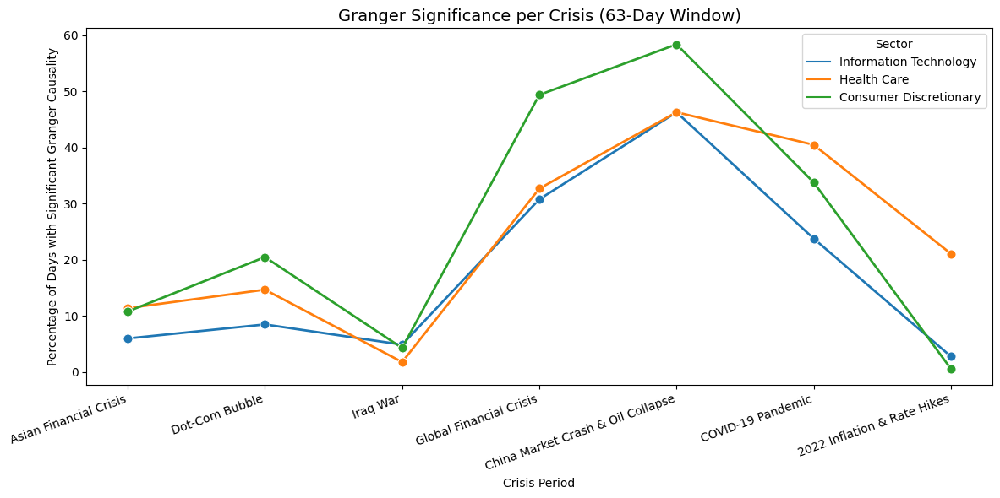

In [15]:
import matplotlib.pyplot as plt
import seaborn as sns

def plot_significance_timeline(sig_df, title="Significance Timeline (p < 0.05)"):
    """
    Plot a timeline of % significant Granger p-values per sector and crisis.
    """
    # Ensure correct order of crises
    crisis_order = sig_df['Crisis'].unique().tolist()
    sig_df['Crisis'] = pd.Categorical(sig_df['Crisis'], categories=crisis_order, ordered=True)

    plt.figure(figsize=(12, 6))
    sns.lineplot(
        data=sig_df,
        x='Crisis',
        y='Significance %',
        hue='Sector',
        marker='o',
        linewidth=2,
        markersize=8
    )

    #plt.axhline(5, color='red', linestyle='--', label='5% Threshold')
    plt.title(title, fontsize=14)
    plt.ylabel("Percentage of Days with Significant Granger Causality")
    plt.xlabel("Crisis Period")
    plt.xticks(rotation=20, ha='right')
    plt.legend(title="Sector")
    plt.grid(False)
    plt.tight_layout()
    plt.show()

    # Create the summary
sig_df_63 = compute_significance_ratio(
    rolling_pvals_df=rolling_joint_pvals[63],
    sectors=sectors,
    crisis_windows=crisis_windows
)

# Plot the timeline
plot_significance_timeline(sig_df_63, title="Granger Significance per Crisis (63-Day Window)")



In [160]:
from statsmodels.tsa.api import VAR

# Extract years from index (assuming datetime index)
data['Year'] = data.index.year
years = data['Year'].unique()

# Store p-values
yearly_pvals = {sector: {'joint': [], 'oil': [], 'vix': [], 'year': []} for sector in sectors}

for year in years:
    yearly_data = data[data['Year'] == year].dropna()

    if len(yearly_data) < 100:
        continue  # Skip years with too little data

    for sector in sectors:
        try:
            vars_subset = ['WTI Log Daily Change', 'VIX Close', sector]
            model_data = yearly_data[vars_subset]
            model = VAR(model_data)
            fitted = model.fit(maxlags=max_lag, ic='bic')

            joint = fitted.test_causality(causing=['WTI Log Daily Change', 'VIX Close'], caused=sector, kind='f').pvalue
            oil_only = fitted.test_causality(causing=['WTI Log Daily Change'], caused=sector, kind='f').pvalue
            vix_only = fitted.test_causality(causing=['VIX Close'], caused=sector, kind='f').pvalue

            yearly_pvals[sector]['joint'].append(joint)
            yearly_pvals[sector]['oil'].append(oil_only)
            yearly_pvals[sector]['vix'].append(vix_only)
            yearly_pvals[sector]['year'].append(year)

        except Exception as e:
            print(f"Skipping {sector} in {year}: {e}")


C:\Users\Nicolaj\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
C:\Users\Nicolaj\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
C:\Users\Nicolaj\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored wh

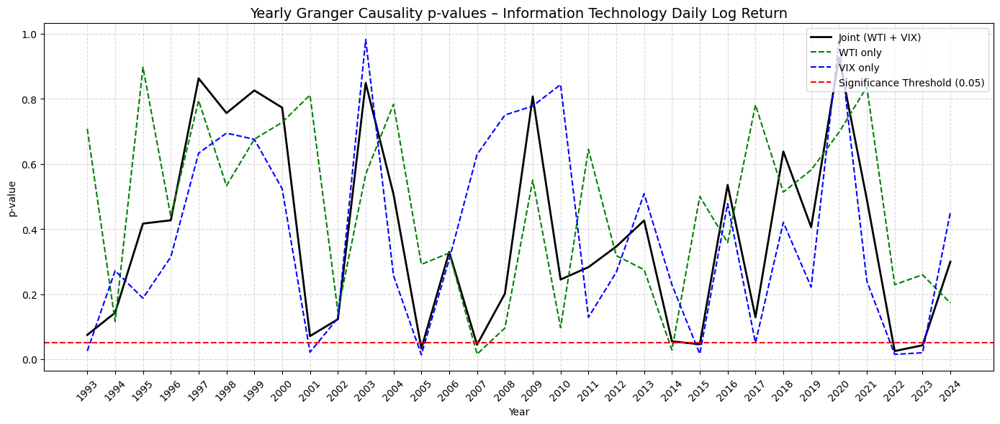

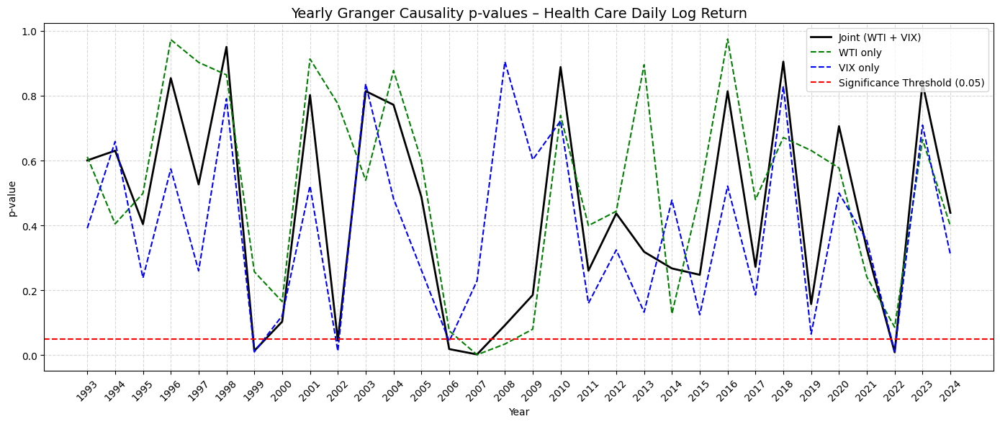

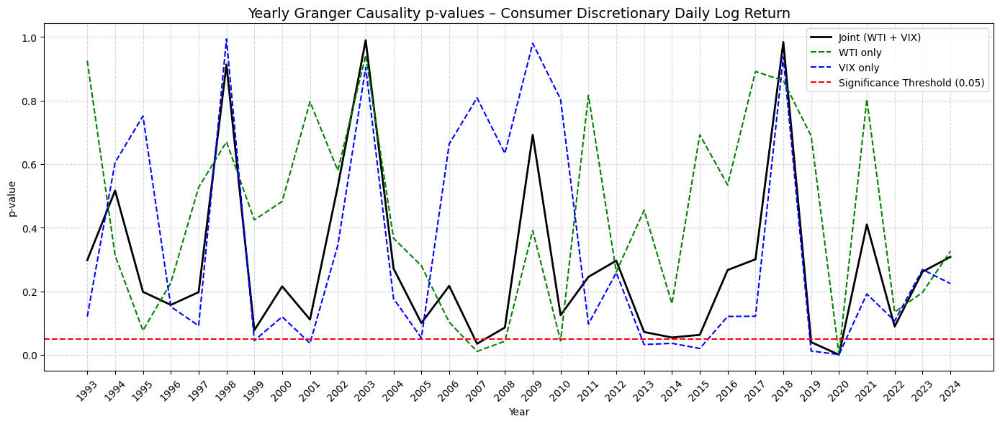

In [161]:
for sector in sectors:
    df = pd.DataFrame(yearly_pvals[sector])
    
    plt.figure(figsize=(14, 6))
    
    plt.plot(df['year'], df['joint'], label="Joint (WTI + VIX)", color='black', linewidth=2.0)
    plt.plot(df['year'], df['oil'], label="WTI only", color='green', linestyle='--', linewidth=1.5)
    plt.plot(df['year'], df['vix'], label="VIX only", color='blue', linestyle='--', linewidth=1.5)

    plt.axhline(0.05, color='red', linestyle='--', label="Significance Threshold (0.05)")
    plt.title(f"Yearly Granger Causality p-values – {sector}", fontsize=14)
    plt.xlabel("Year")
    plt.ylabel("p-value")
    plt.legend(loc="upper right")
    plt.grid(True, linestyle='--', alpha=0.5)
    plt.xticks(df['year'], rotation=45)
    plt.tight_layout()
    plt.show()


In [16]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from statsmodels.tsa.api import VAR

def plot_girf_crisis_grid(data, sectors, crisis_subset, title, n_steps=10, max_lag=6, n_repl=300, signif=0.05):
    num_crises = len(crisis_subset)
    fig, axes = plt.subplots(6, num_crises, figsize=(5 * num_crises, 12), sharex=True)
    fig.subplots_adjust(hspace=0.5, wspace=0.3)

    shock_vars = ['WTI Log Daily Change', 'VIX Close']
    x = np.arange(n_steps + 1)
    shock_colors = ['green', 'blue']
    shock_labels = ['WTI Shock', 'VIX Shock']

    # Titles for sector rows
    sector_labels = [s.replace(' Daily Log Return', '') for s in sectors]

    for col, (crisis_name, start, end) in enumerate(crisis_subset):
        for s_idx, sector in enumerate(sectors):
            for shock_row in range(2):  # 0 = WTI, 1 = VIX
                row = s_idx * 2 + shock_row
                ax = axes[row, col] if num_crises > 1 else axes[row]

                try:
                    subset = data.loc[pd.to_datetime(start):pd.to_datetime(end), shock_vars + [sector]].dropna()
                    if len(subset) < (max_lag + n_steps + 1):
                        ax.text(0.5, 0.5, 'Insufficient data', ha='center', va='center')
                        ax.axis('off')
                        continue

                    model = VAR(subset)
                    fitted = model.fit(maxlags=max_lag, ic='bic')
                    irf = fitted.irf(n_steps)
                    lower, upper = irf.errband_mc(orth=False, repl=n_repl, signif=signif)

                    sector_idx = subset.columns.get_loc(sector)
                    shock_idx = shock_row

                    y = irf.irfs[:, sector_idx, shock_idx]
                    y_low = lower[:, sector_idx, shock_idx]
                    y_high = upper[:, sector_idx, shock_idx]

                    ax.plot(x, y, color=shock_colors[shock_row])
                    ax.fill_between(x, y_low, y_high, color=shock_colors[shock_row], alpha=0.2)
                    ax.axhline(0, color='gray', linestyle='--')
                    ax.grid(False)

                    if row == 0:
                        ax.set_title(crisis_name, fontsize=11)
                    if col == 0:
                        ax.set_ylabel("Response", fontsize=10)
                    if row == 5:
                        ax.set_xlabel("Days After Shock")

                except Exception as e:
                    ax.text(0.5, 0.5, 'Error', ha='center', va='center')
                    ax.set_title(f"{crisis_name} (Error)", fontsize=10)
                    ax.axis('off')
                    print(f"Error in {sector} during {crisis_name}: {e}")

    # Add sector subtitles to the left of each 2-row block
    for s_idx, label in enumerate(sector_labels):
        fig.text(0.02, 0.87 - s_idx * 0.285, label, va='center', rotation='vertical', fontsize=12, fontweight='bold')

    # Shared legend
    handles = [
        plt.Line2D([0], [0], color='green', label='WTI Shock'),
        plt.Line2D([0], [0], color='blue', label='VIX Shock')
    ]
    fig.legend(handles=handles, loc='lower center', ncol=2, fontsize=10, bbox_to_anchor=(0.5, -0.015))

    fig.suptitle(title, fontsize=15, y=1.02)
    plt.tight_layout(rect=[0.03, 0.03, 1, 0.97])
    plt.show()


In [ ]:
# Crisis split examples
pre_gfc = crisis_windows[:3]
post_gfc = crisis_windows[3:]

# Run figure
plot_girf_crisis_grid(data, sectors, pre_gfc, title="Crisis GIRFs – Pre-GFC")
plot_girf_crisis_grid(data, sectors, post_gfc, title="Crisis GIRFs – GFC and Beyond")

C:\Users\nicol\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.10_qbz5n2kfra8p0\LocalCache\local-packages\Python310\site-packages\statsmodels\tsa\base\tsa_model.py:471: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
C:\Users\nicol\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.10_qbz5n2kfra8p0\LocalCache\local-packages\Python310\site-packages\statsmodels\tsa\base\tsa_model.py:471: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
C:\Users\nicol\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.10_qbz5n2kfra8p0\LocalCache\local-packages\Python310\site-packages\statsmodels\tsa\base\tsa_model.py:471: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g

### Crisis Zoom in for Return Behavior

#### Extreme Value Theory

Health Care Daily Log Return: Shape = 0.4548, Scale = 0.0067
Information Technology Daily Log Return: Shape = 0.4309, Scale = 0.0095
Consumer Discretionary Daily Log Return: Shape = 0.5180, Scale = 0.0078


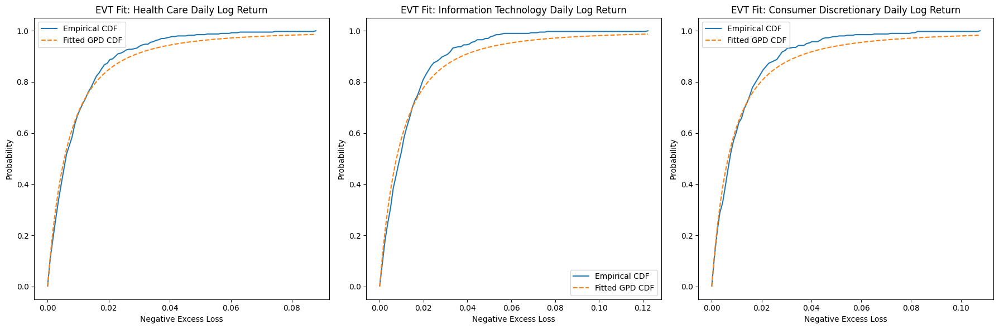

In [62]:
import numpy as np
import pandas as pd
import scipy.stats as stats
import matplotlib.pyplot as plt
from statsmodels.distributions.empirical_distribution import ECDF
from scipy.stats import genpareto

# Define the sectors
#sectors = ['Health Care Daily Return', 'Information Technology Daily Return', 'Consumer Discretionary Daily Return']
sectors = ['Health Care Daily Log Return', 'Information Technology Daily Log Return', 'Consumer Discretionary Daily Log Return']


# Threshold for POT (e.g., 5th percentile)
thresholds = {sector: np.percentile(data[sector], 5) for sector in sectors}

# Fit GPD for extreme losses in each sector
gpd_params = {}
for sector in sectors:
    excess_losses = data[data[sector] < thresholds[sector]][sector] - thresholds[sector]
    shape, loc, scale = genpareto.fit(-excess_losses)  # Fit GPD
    gpd_params[sector] = {'shape': shape, 'scale': scale}
    print(f"{sector}: Shape = {shape:.4f}, Scale = {scale:.4f}")

# Plot empirical CDF and fitted GPD for each sector
plt.figure(figsize=(18, 6))

for i, sector in enumerate(sectors):
    excess_losses = data[data[sector] < thresholds[sector]][sector] - thresholds[sector]
    ecdf = ECDF(-excess_losses)
    x = np.linspace(min(-excess_losses), max(-excess_losses), 100)
    
    plt.subplot(1, 3, i + 1)
    plt.plot(x, ecdf(x), label='Empirical CDF')
    plt.plot(x, genpareto.cdf(x, *genpareto.fit(-excess_losses)), label='Fitted GPD CDF', linestyle='dashed')
    plt.xlabel("Negative Excess Loss")
    plt.ylabel("Probability")
    plt.title(f"EVT Fit: {sector}")
    plt.legend()

plt.tight_layout()
plt.show()


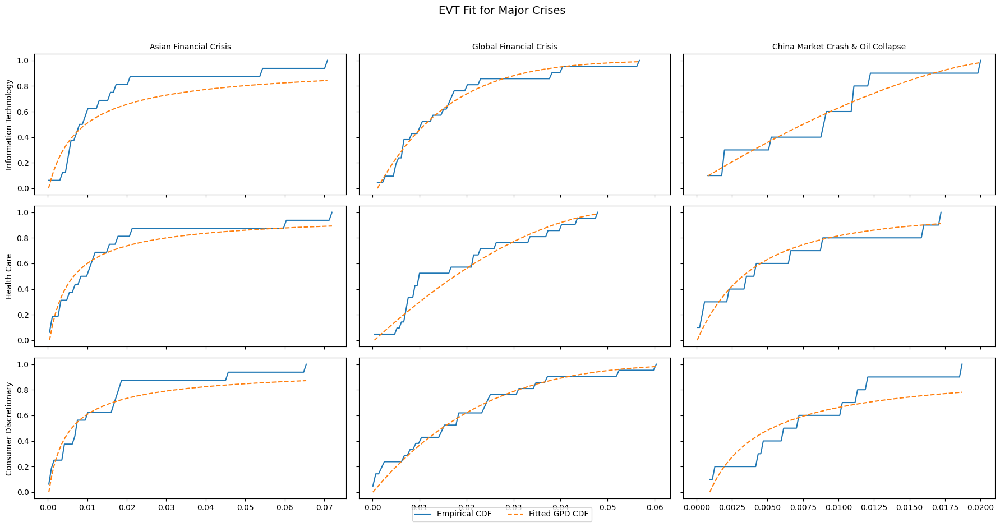

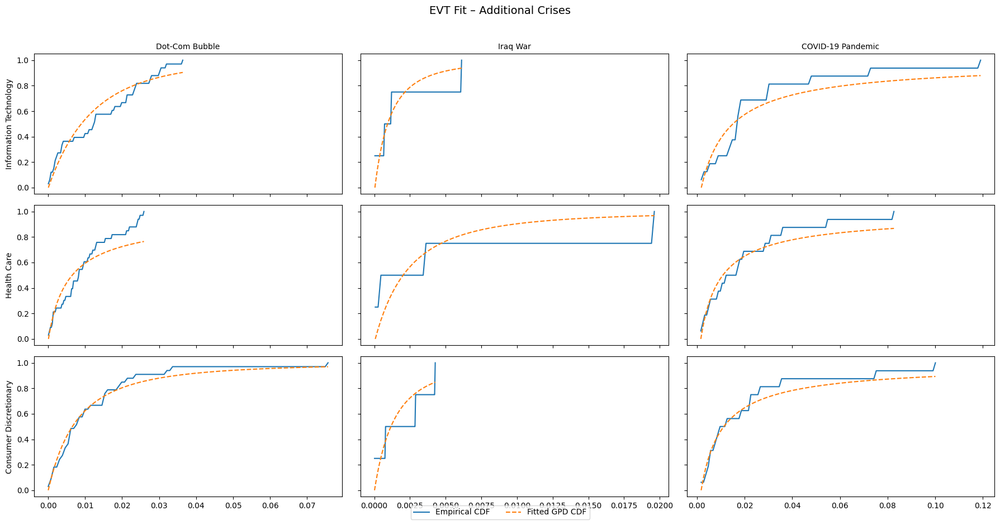

In [68]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from scipy.stats import genpareto
from statsmodels.distributions.empirical_distribution import ECDF

# === Configuration ===
sectors = [

    'Information Technology Daily Log Return',
     'Health Care Daily Log Return',
    'Consumer Discretionary Daily Log Return'
]

# === Crisis periods ===
crisis_groups = {
    "Main Crises (3x3)": [
        ("Asian Financial Crisis", "1997-07-01", "1998-10-01"),
        ("Global Financial Crisis", "2007-07-01", "2009-03-01"),
        ("China Market Crash & Oil Collapse", "2015-06-01", "2016-03-01"),
    ],
    "Appendix Crises (3x3)": [
        ("Dot-Com Bubble", "2000-03-01", "2002-10-01"),
        ("Iraq War", "2003-10-01", "2003-12-31"),
        ("COVID-19 Pandemic", "2020-03-01", "2021-06-01"),
    ]
}

# === Function to plot EVT fits ===
def plot_evt_crisis_grid(data, crises, title):
    fig, axes = plt.subplots(len(sectors), len(crises), figsize=(18, 9), sharey='row', sharex='col')
    fig.subplots_adjust(hspace=0.3, wspace=0.3)

    for col, (crisis_name, start, end) in enumerate(crises):
        subset = data.loc[pd.to_datetime(start):pd.to_datetime(end)]

        for row, sector in enumerate(sectors):
            ax = axes[row, col]
            try:
                threshold = np.percentile(subset[sector], 5)
                excess_losses = subset[subset[sector] < threshold][sector] - threshold
                ecdf = ECDF(-excess_losses)
                x = np.linspace(min(-excess_losses), max(-excess_losses), 100)

                # Plot
                ax.plot(x, ecdf(x), label='Empirical CDF')
                ax.plot(x, genpareto.cdf(x, *genpareto.fit(-excess_losses)), 
                        label='Fitted GPD CDF', linestyle='dashed')
                ax.set_title(f"{crisis_name}", fontsize=10) if row == 0 else None
                ax.set_ylabel(sector.replace(" Daily Log Return", ""), fontsize=10) if col == 0 else None
                ax.grid(False)

            except Exception as e:
                ax.set_title(f"{crisis_name} (error)")
                print(f"Error in {sector} - {crisis_name}: {e}")

    handles, labels = axes[0, 0].get_legend_handles_labels()
    fig.legend(handles, labels, loc='lower center', ncol=3, bbox_to_anchor=(0.5, -0.01))
    plt.suptitle(title, fontsize=14, y=1.02)
    plt.tight_layout()
    plt.show()

# === Plot both groups ===
plot_evt_crisis_grid(data, crisis_groups["Main Crises (3x3)"], title="EVT Fit for Major Crises")
plot_evt_crisis_grid(data, crisis_groups["Appendix Crises (3x3)"], title="EVT Fit – Additional Crises")


In [73]:
import numpy as np
import pandas as pd
from scipy.stats import genpareto

# === Define sectors and crisis periods ===
sectors = [
    'Health Care Daily Log Return',
    'Information Technology Daily Log Return',
    'Consumer Discretionary Daily Log Return'
]

crisis_periods = [
    ("Asian Financial Crisis", "1997-07-01", "1998-10-01"),
    ("Global Financial Crisis", "2007-07-01", "2009-03-01"),
    ("China Market Crash & Oil Collapse", "2015-06-01", "2016-03-01"),
    ("Dot-Com Bubble", "2000-03-01", "2002-10-01"),
    ("Iraq War", "2003-10-01", "2003-12-31"),
    ("COVID-19 Pandemic", "2020-03-01", "2021-06-01")
]

# === Prepare storage ===
evt_params = []

# === Loop through each crisis and sector ===
for crisis_name, start_date, end_date in crisis_periods:
    subset = data.loc[pd.to_datetime(start_date):pd.to_datetime(end_date)]

    for sector in sectors:
        try:
            threshold = np.percentile(subset[sector], 5)
            excess_losses = subset[subset[sector] < threshold][sector] - threshold

            # Fit GPD to negative excess losses
            shape, loc, scale = genpareto.fit(-excess_losses)

            evt_params.append({
                "Crisis": crisis_name,
                "Sector": sector.replace(" Daily Log Return", ""),
                "Shape (ξ)": round(shape, 4),
                "Scale (β)": round(scale, 4),
                "Threshold (5%)": round(threshold, 4)
            })

        except Exception as e:
            evt_params.append({
                "Crisis": crisis_name,
                "Sector": sector.replace(" Daily Log Return", ""),
                "Shape (ξ)": np.nan,
                "Scale (β)": np.nan,
                "Threshold (5%)": np.nan
            })
            print(f"⚠️ Error in {sector} during {crisis_name}: {e}")

# === Convert to DataFrame ===
evt_df = pd.DataFrame(evt_params)

# === Preview (optional) ===
print(evt_df)

# === Optional: save to file
# evt_df.to_csv("evt_gpd_parameters_by_crisis.csv", index=False)


                               Crisis                  Sector  Shape (ξ)  \
0              Asian Financial Crisis             Health Care     1.2965   
1              Asian Financial Crisis  Information Technology     1.3994   
2              Asian Financial Crisis  Consumer Discretionary     1.4973   
3             Global Financial Crisis             Health Care    -0.5786   
4             Global Financial Crisis  Information Technology    -0.0982   
5             Global Financial Crisis  Consumer Discretionary    -0.2233   
6   China Market Crash & Oil Collapse             Health Care     0.4461   
7   China Market Crash & Oil Collapse  Information Technology    -0.6605   
8   China Market Crash & Oil Collapse  Consumer Discretionary     1.2347   
9                      Dot-Com Bubble             Health Care     1.4023   
10                     Dot-Com Bubble  Information Technology     0.2188   
11                     Dot-Com Bubble  Consumer Discretionary     0.5127   
12          

#### CVAR

In [71]:
import numpy as np
import pandas as pd

# === Input (Make sure `data` has datetime index and sector columns) ===
sectors = [
    'Health Care Daily Log Return',
    'Information Technology Daily Log Return',
    'Consumer Discretionary Daily Log Return'
]

crisis_periods = [
    ("Asian Financial Crisis", "1997-07-01", "1998-10-01"),
    ("Global Financial Crisis", "2007-07-01", "2009-03-01"),
    ("China Market Crash & Oil Collapse", "2015-06-01", "2016-03-01"),
    ("Dot-Com Bubble", "2000-03-01", "2002-10-01"),
    ("Iraq War", "2003-10-01", "2003-12-31"),
    ("COVID-19 Pandemic", "2020-03-01", "2021-06-01")
]

alpha_levels = [0.95, 0.99]

# === Compute CVaR ===
cvar_records = []

for crisis_name, start_date, end_date in crisis_periods:
    subset = data.loc[pd.to_datetime(start_date):pd.to_datetime(end_date)]
    
    for sector in sectors:
        record = {
            'Crisis': crisis_name,
            'Sector': sector.replace(" Daily Log Return", "")
        }
        
        for alpha in alpha_levels:
            try:
                var = np.percentile(subset[sector], 100 * (1 - alpha))
                cvar = subset[subset[sector] < var][sector].mean()
                record[f'CVaR {int(alpha * 100)}%'] = round(cvar, 5)
            except:
                record[f'CVaR {int(alpha * 100)}%'] = np.nan
        
        cvar_records.append(record)

# === Output as DataFrame ===
cvar_df = pd.DataFrame(cvar_records)

# === Optional: Save or display ===
print(cvar_df)
# cvar_df.to_csv("cvar_by_crisis.csv", index=False)


                               Crisis                  Sector  CVaR 95%  \
0              Asian Financial Crisis             Health Care  -0.03515   
1              Asian Financial Crisis  Information Technology  -0.04480   
2              Asian Financial Crisis  Consumer Discretionary  -0.03405   
3             Global Financial Crisis             Health Care  -0.04466   
4             Global Financial Crisis  Information Technology  -0.05520   
5             Global Financial Crisis  Consumer Discretionary  -0.05926   
6   China Market Crash & Oil Collapse             Health Care  -0.02916   
7   China Market Crash & Oil Collapse  Information Technology  -0.03124   
8   China Market Crash & Oil Collapse  Consumer Discretionary  -0.02990   
9                      Dot-Com Bubble             Health Care  -0.03617   
10                     Dot-Com Bubble  Information Technology  -0.06131   
11                     Dot-Com Bubble  Consumer Discretionary  -0.03940   
12                       

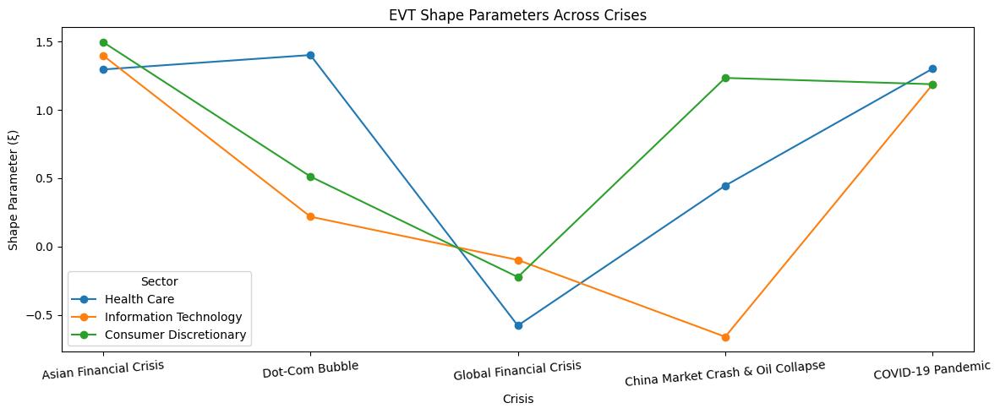

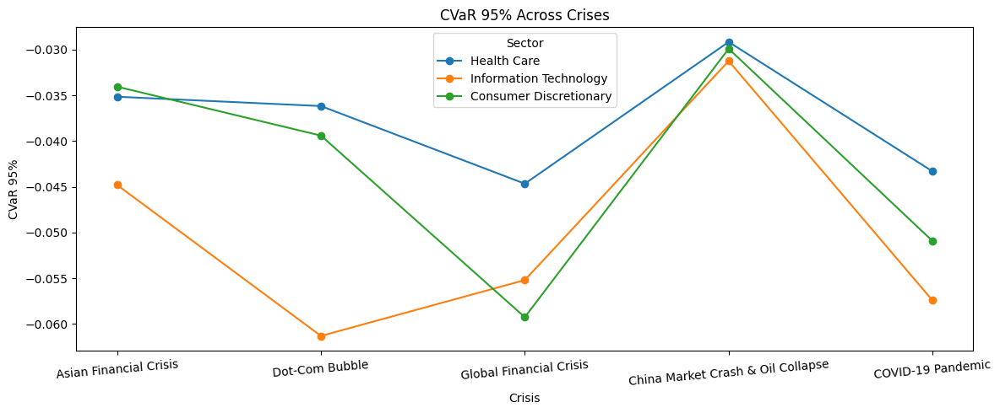

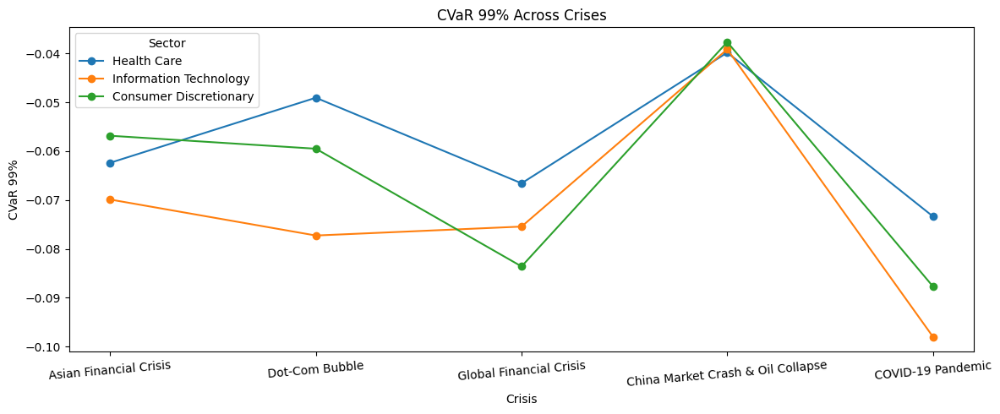

In [75]:
import matplotlib.pyplot as plt

# === Settings ===
crisis_labels = [
    "Asian Financial Crisis",
    "Dot-Com Bubble",
   # "Iraq War",
    "Global Financial Crisis",
    "China Market Crash & Oil Collapse",
    "COVID-19 Pandemic"
]

sectors = [
    "Health Care",
    "Information Technology",
    "Consumer Discretionary"
]

# === Prepare Data ===

# EVT Shape Parameters (from evt_df)
evt_shape_data = {
    sector: [evt_df[(evt_df['Sector'] == sector) & (evt_df['Crisis'] == crisis)]['Shape (ξ)'].values[0]
             for crisis in crisis_labels]
    for sector in sectors
}

# CVaR 95% and 99% (from cvar_df)
cvar_95_data = {
    sector: [cvar_df[(cvar_df['Sector'] == sector) & (cvar_df['Crisis'] == crisis)]['CVaR 95%'].values[0]
             for crisis in crisis_labels]
    for sector in sectors
}

cvar_99_data = {
    sector: [cvar_df[(cvar_df['Sector'] == sector) & (cvar_df['Crisis'] == crisis)]['CVaR 99%'].values[0]
             for crisis in crisis_labels]
    for sector in sectors
}

# === Plot EVT Shape Parameters ===
plt.figure(figsize=(12, 5))
for sector, shape_vals in evt_shape_data.items():
    plt.plot(crisis_labels, shape_vals, marker='o', label=sector)

plt.xlabel("Crisis")
plt.ylabel("Shape Parameter (ξ)")
plt.title("EVT Shape Parameters Across Crises")
plt.xticks(rotation=5)
plt.grid(False)
plt.legend(title="Sector")
plt.tight_layout()
plt.show()

# === Plot CVaR 95% ===
plt.figure(figsize=(12, 5))
for sector, cvar_vals in cvar_95_data.items():
    plt.plot(crisis_labels, cvar_vals, marker='o', label=sector)

plt.xlabel("Crisis")
plt.ylabel("CVaR 95%")
plt.title("CVaR 95% Across Crises")
plt.xticks(rotation=5)
plt.grid(False)
plt.legend(title="Sector")
plt.tight_layout()
plt.show()

# === Plot CVaR 99% ===
plt.figure(figsize=(12, 5))
for sector, cvar_vals in cvar_99_data.items():
    plt.plot(crisis_labels, cvar_vals, marker='o', label=sector)

plt.xlabel("Crisis")
plt.ylabel("CVaR 99%")
plt.title("CVaR 99% Across Crises")
plt.xticks(rotation=5)
plt.grid(False)
plt.legend(title="Sector")
plt.tight_layout()
plt.show()


#### Return behavior for different oil price changes during the different crises

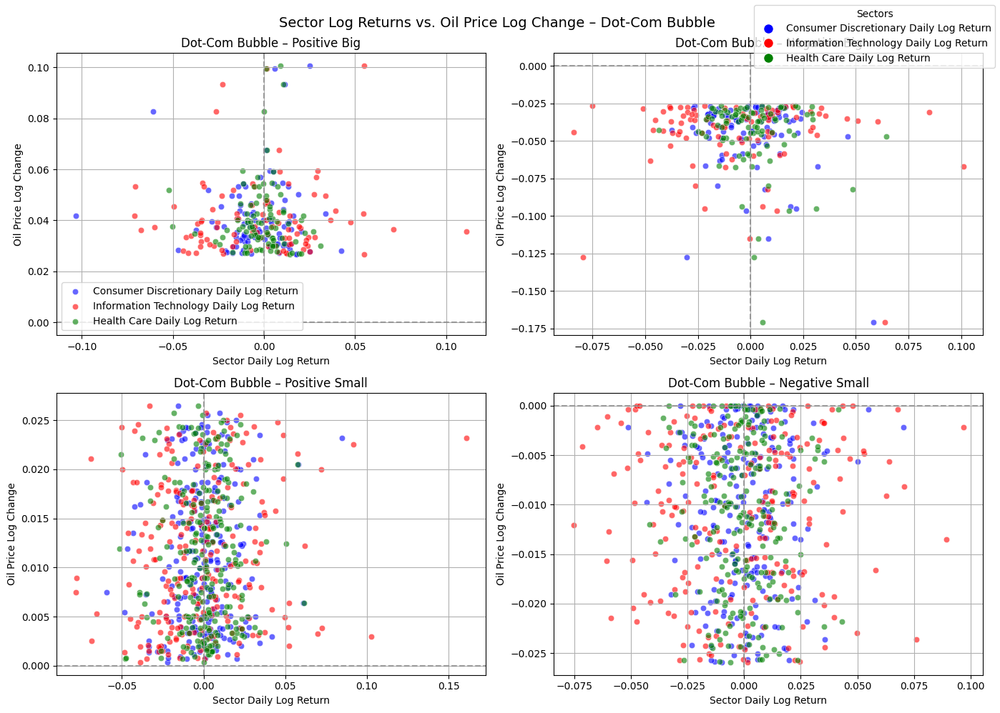

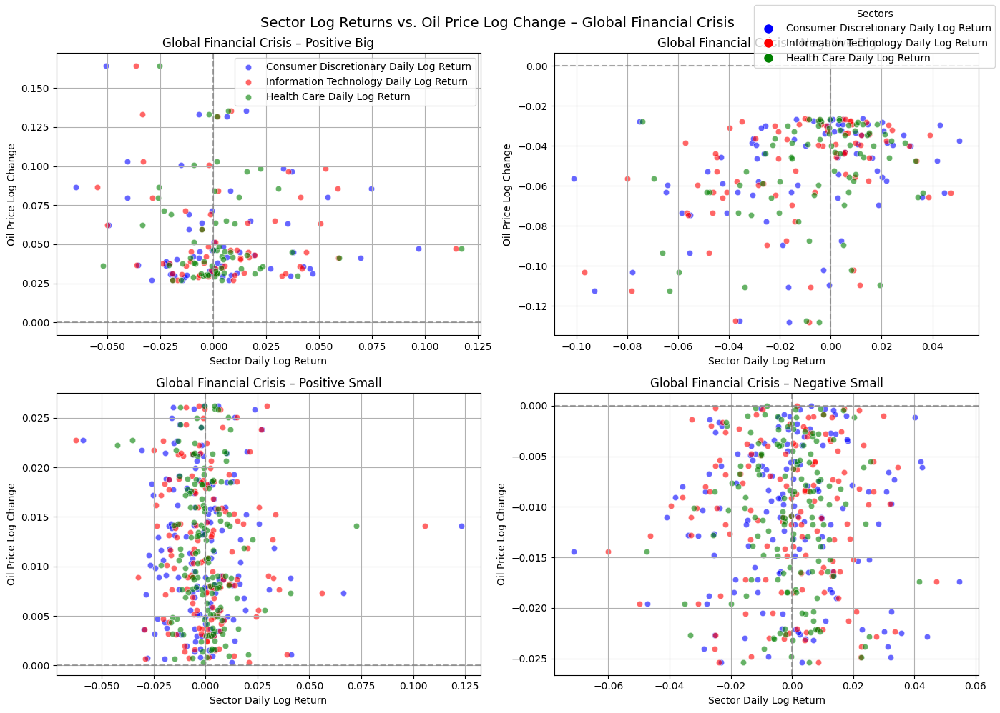

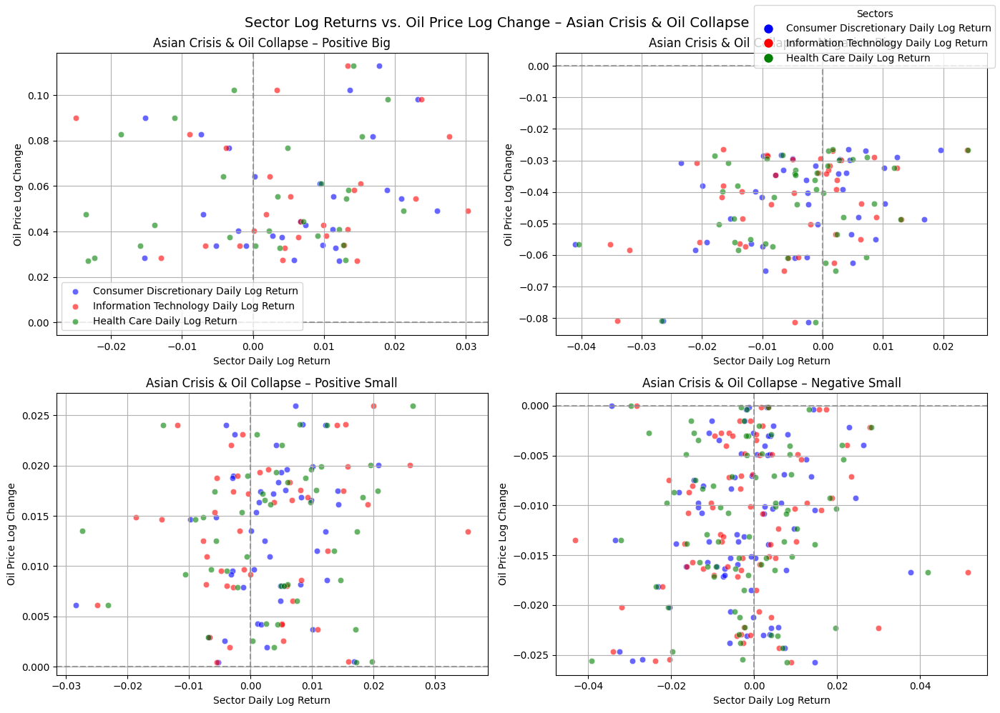

In [44]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

# Compute mean and standard deviation
mean_wti = data['WTI Log Daily Change'].mean()
std_wti = data['WTI Log Daily Change'].std()

# Define thresholds
data['WTI Change Category'] = pd.cut(
    data['WTI Log Daily Change'],
    bins=[-np.inf, mean_wti - std_wti, 0, mean_wti + std_wti, np.inf],
    labels=['Negative Big', 'Negative Small', 'Positive Small', 'Positive Big']
)


# === Settings ===
sector_features = [
    "Consumer Discretionary Daily Log Return",
    "Information Technology Daily Log Return",
    "Health Care Daily Log Return"
]

oil_change_types = ['Positive Big', 'Negative Big', 'Positive Small', 'Negative Small']

sector_colors = {
    "Consumer Discretionary Daily Log Return": "blue",
    "Information Technology Daily Log Return": "red",
    "Health Care Daily Log Return": "green"
}

# === Crisis periods to examine ===
crisis_periods = {
    "Dot-Com Bubble": ("2000-03-01", "2002-10-01"),
    "Global Financial Crisis": ("2007-07-01", "2009-03-01"),
    "Asian Crisis & Oil Collapse": ("2015-06-01", "2016-03-01")
}

# Ensure datetime index for filtering
data.index = pd.to_datetime(data.index)

# === Plot by crisis period ===
for crisis_name, (start_date, end_date) in crisis_periods.items():
    crisis_data = data.loc[start_date:end_date]

    fig, axes = plt.subplots(2, 2, figsize=(14, 10))
    axes = axes.flatten()

    for i, oil_change in enumerate(oil_change_types):
        subset = crisis_data[crisis_data['WTI Change Category'] == oil_change]

        ax = axes[i]
        for sector in sector_features:
            sns.scatterplot(data=subset, x=sector, y="WTI Log Daily Change",
                            color=sector_colors[sector], alpha=0.6, ax=ax, label=sector if i == 0 else "_nolegend_")

        ax.axvline(x=0, color='gray', linestyle='--', alpha=0.7)
        ax.axhline(y=0, color='gray', linestyle='--', alpha=0.7)
        ax.set_title(f"{crisis_name} – {oil_change}")
        ax.set_xlabel("Sector Daily Log Return")
        ax.set_ylabel("Oil Price Log Change")
        ax.grid(True)

    # Legend
    handles = [
        plt.Line2D([0], [0], marker='o', color='w', markerfacecolor=sector_colors[sector], markersize=10, label=sector)
        for sector in sector_features
    ]
    fig.legend(handles=handles, loc="upper right", title="Sectors")

    plt.suptitle(f"Sector Log Returns vs. Oil Price Log Change – {crisis_name}", fontsize=14)
    plt.tight_layout()
    plt.show()


Not really important, but may come in handy.

#### Statistical Tests for Comparison

In [45]:
import numpy as np
import pandas as pd
from scipy import stats

# === SETTINGS ===
sector_features = [
    "Consumer Discretionary Daily Log Return",
    "Information Technology Daily Log Return",
    "Health Care Daily Log Return"
]

categories = ['Positive Big', 'Negative Big', 'Positive Small', 'Negative Small']

crisis_periods = {
    "Dot-Com Bubble": ("2000-03-01", "2002-10-01"),
    "Global Financial Crisis": ("2007-07-01", "2009-03-01"),
    "Asian Crisis & Oil Collapse": ("2015-06-01", "2016-03-01")
}

# === HELPER FUNCTION ===
def bootstrap_ci(data, n_bootstrap=1000, ci=95):
    boot_means = np.random.choice(data, (n_bootstrap, len(data)), replace=True).mean(axis=1)
    lower_bound = np.percentile(boot_means, (100 - ci) / 2)
    upper_bound = np.percentile(boot_means, 100 - (100 - ci) / 2)
    return lower_bound, upper_bound

# === CONTAINERS FOR RESULTS ===
kruskal_results = []
mannwhitney_results = []
bootstrap_results = []

# === RUN ANALYSIS FOR EACH CRISIS & CATEGORY ===
for crisis_name, (start, end) in crisis_periods.items():
    crisis_data = data.loc[start:end]

    for cat in categories:
        subset = crisis_data[crisis_data['WTI Change Category'] == cat]

        # --- Kruskal-Wallis ---
        kruskal_stat, kruskal_p = stats.kruskal(
            subset[sector_features[0]],
            subset[sector_features[1]],
            subset[sector_features[2]]
        )
        kruskal_results.append({
            "Crisis": crisis_name,
            "WTI Category": cat,
            "Kruskal p-value": kruskal_p
        })

        # --- Mann-Whitney U Tests ---
        u_hc_it, p_hc_it = stats.mannwhitneyu(subset[sector_features[2]], subset[sector_features[1]])
        u_hc_cd, p_hc_cd = stats.mannwhitneyu(subset[sector_features[2]], subset[sector_features[0]])
        u_it_cd, p_it_cd = stats.mannwhitneyu(subset[sector_features[1]], subset[sector_features[0]])

        mannwhitney_results.extend([
            {"Crisis": crisis_name, "WTI Category": cat, "Pair": "Health Care vs IT", "p-value": p_hc_it},
            {"Crisis": crisis_name, "WTI Category": cat, "Pair": "Health Care vs CD", "p-value": p_hc_cd},
            {"Crisis": crisis_name, "WTI Category": cat, "Pair": "IT vs CD", "p-value": p_it_cd}
        ])

        # --- Bootstrap Confidence Intervals ---
        for sector in sector_features:
            values = subset[sector].dropna().values
            if len(values) > 0:
                mean_val = np.mean(values)
                lower, upper = bootstrap_ci(values)
                bootstrap_results.append({
                    "Crisis": crisis_name,
                    "WTI Category": cat,
                    "Sector": sector.replace(" Daily Log Return", ""),
                    "Mean": mean_val,
                    "CI Lower": lower,
                    "CI Upper": upper
                })

# === CREATE AND EXPORT DATAFRAMES ===
kruskal_df = pd.DataFrame(kruskal_results)
mannwhitney_df = pd.DataFrame(mannwhitney_results)
bootstrap_df = pd.DataFrame(bootstrap_results)

# === OPTIONAL: Display or Save to CSV ===
print("\n=== Kruskal-Wallis p-values ===")
print(kruskal_df)

print("\n=== Mann-Whitney U Test p-values ===")
print(mannwhitney_df)

print("\n=== Bootstrap Means and Confidence Intervals ===")
print(bootstrap_df)

# To save to CSV:
# kruskal_df.to_csv("kruskal_results.csv", index=False)
# mannwhitney_df.to_csv("mannwhitney_results.csv", index=False)
# bootstrap_df.to_csv("bootstrap_means_ci.csv", index=False)



=== Kruskal-Wallis p-values ===
                         Crisis    WTI Category  Kruskal p-value
0                Dot-Com Bubble    Positive Big         0.771305
1                Dot-Com Bubble    Negative Big         0.060995
2                Dot-Com Bubble  Positive Small         0.106155
3                Dot-Com Bubble  Negative Small         0.732954
4       Global Financial Crisis    Positive Big         0.766606
5       Global Financial Crisis    Negative Big         0.591817
6       Global Financial Crisis  Positive Small         0.295842
7       Global Financial Crisis  Negative Small         0.878847
8   Asian Crisis & Oil Collapse    Positive Big         0.400817
9   Asian Crisis & Oil Collapse    Negative Big         0.814769
10  Asian Crisis & Oil Collapse  Positive Small         0.649418
11  Asian Crisis & Oil Collapse  Negative Small         0.990377

=== Mann-Whitney U Test p-values ===
                         Crisis    WTI Category               Pair   p-value
0      

Kruskal p-values to detect any differences across WTI types.

Mann-Whitney U p-values to pinpoint which types differ.

In [46]:
from itertools import combinations
from scipy.stats import kruskal, mannwhitneyu

# Prepare containers
within_sector_kruskal = []
within_sector_pairwise = []

# All pairwise combinations of WTI categories
category_pairs = list(combinations(categories, 2))

# Iterate through crisis and sector
for crisis_name, (start, end) in crisis_periods.items():
    crisis_data = data.loc[start:end]

    for sector in sector_features:
        sector_label = sector.replace(" Daily Log Return", "")

        # Prepare data grouped by WTI Category
        grouped = {cat: crisis_data[crisis_data['WTI Change Category'] == cat][sector].dropna() for cat in categories}

        # --- Kruskal-Wallis test ---
        if all(len(grouped[cat]) > 0 for cat in categories):
            h_stat, p_val = kruskal(*[grouped[cat] for cat in categories])
            within_sector_kruskal.append({
                "Crisis": crisis_name,
                "Sector": sector_label,
                "Kruskal p-value": p_val
            })

        # --- Pairwise Mann-Whitney U Tests ---
        for cat1, cat2 in category_pairs:
            if len(grouped[cat1]) > 0 and len(grouped[cat2]) > 0:
                u_stat, p_pair = mannwhitneyu(grouped[cat1], grouped[cat2])
                within_sector_pairwise.append({
                    "Crisis": crisis_name,
                    "Sector": sector_label,
                    "Comparison": f"{cat1} vs. {cat2}",
                    "p-value": p_pair
                })

# Convert to DataFrames
within_sector_kruskal_df = pd.DataFrame(within_sector_kruskal)
within_sector_pairwise_df = pd.DataFrame(within_sector_pairwise)

# Display results
print("=== Kruskal-Wallis (Across WTI Categories) ===")
print(within_sector_kruskal_df)

print("\n=== Pairwise Mann-Whitney U (Across WTI Categories) ===")
print(within_sector_pairwise_df)

# Optional export
# within_sector_kruskal_df.to_csv("sector_kruskal_by_crisis.csv", index=False)
# within_sector_pairwise_df.to_csv("sector_pairwise_u_by_crisis.csv", index=False)


=== Kruskal-Wallis (Across WTI Categories) ===
                        Crisis                  Sector  Kruskal p-value
0               Dot-Com Bubble  Consumer Discretionary         0.663707
1               Dot-Com Bubble  Information Technology         0.558000
2               Dot-Com Bubble             Health Care         0.474284
3      Global Financial Crisis  Consumer Discretionary         0.396286
4      Global Financial Crisis  Information Technology         0.022749
5      Global Financial Crisis             Health Care         0.642575
6  Asian Crisis & Oil Collapse  Consumer Discretionary         0.000205
7  Asian Crisis & Oil Collapse  Information Technology         0.000331
8  Asian Crisis & Oil Collapse             Health Care         0.003045

=== Pairwise Mann-Whitney U (Across WTI Categories) ===
                         Crisis                  Sector   
0                Dot-Com Bubble  Consumer Discretionary  \
1                Dot-Com Bubble  Consumer Discretionary   

## Forecasting

In [ ]:
#data_forecast = data.copy()
#data_forecast = data_forecast.dropna()
#data_forecast = pd.read_csv("ForecastData.csv")

In [ ]:
# save as ForecastData.csv
#data_forecast.to_csv("ForecastData.csv", index=True)

In [4]:
data_forecast = pd.read_csv("ForecastData.csv", index_col=0)

In [ ]:
# Date to datetime
data_forecast.index = pd.to_datetime(data_forecast.index)

In [6]:
# load csv ProcessedData_2025.csv
data_forecast_2025 = pd.read_csv("ProcessedData_2025.csv", index_col=0)
data_forecast_2025.index = pd.to_datetime(data_forecast_2025.index)
# for now we will only use VIX Close, WTI Spot Price, IT Adj Close_Return, HC Adj Close_Return AND CD Adj Close_Return, IT Volume, HD Volume, CD Volume
data_forecast_2025 = data_forecast_2025[['VIX Close', 'WTI Log Daily Change', 'IT_Log_Return', 'HC_Log_Return', 'CD_Log_Return', 'IT Volume', 'HC Volume', 'CD Volume']]
# rename VIX Close to VIX, IT Adj Close_Return to IT Daily Return, HC Adj Close_Return to HC Daily Return, CD Adj Close_Return to CD Daily Return
data_forecast_2025.rename(columns={'VIX Close': 'VIX'})#, 'IT_Return': 'IT Daily Return', 'HC Adj Close_Return': 'HC Daily Return', 'CD Adj Close_Return': 'CD Daily Return'}, inplace=True)
# remame HC Daily Return to Health Care Daily Return, CD Daaily Return to Consumer Discretionary Daily Return, IT Daily Return to Information Technology Daily Return
data_forecast_2025.rename(columns={'HC_Log_Return': 'Health Care Daily Log Return', 'CD_Log_Return': 'Consumer Discretionary Daily Log Return', 'IT_Log_Return': 'Information Technology Daily Log Return'}, inplace=True)
data_forecast_2025.head()

# Define sectors
sectors = ['Health Care Daily Log Return', 'Information Technology Daily Log Return', 'Consumer Discretionary Daily Log Return']

# Define event-based high uncertainty periods
high_uncertainty_periods = [
    ("Asian Financial Crisis", "1997-07-01", "1998-10-01"),
    ("Dot-Com Bubble", "2000-03-01", "2002-10-01"),
    ("Post-9/11 Market Shock", "2001-09-11", "2001-12-31"),
    ("Iraq War", "2003-10-01", "2003-12-31"),
    ("Global Financial Crisis", "2007-07-01", "2009-03-01"),
    ("European Debt Crisis", "2010-05-01", "2012-06-01"),
    ("US Debt Ceiling Crisis", "2011-07-01", "2011-08-31"),
    ("China Market Crash & Oil Collapse", "2015-06-01", "2016-03-01"),
    ("COVID-19 Pandemic", "2020-03-01", "2021-06-01"),
    ("2022 Inflation & Rate Hikes", "2022-01-01", "2023-06-01")
]

# Convert dates to datetime format
data_forecast_2025.index = pd.to_datetime(data_forecast_2025.index)
 # Assign "High Uncertainty" based on event classification
data_forecast_2025["Uncertainty Regime"] = "Normal Uncertainty"  # Default category
for _, start, end in high_uncertainty_periods:
    mask = (data_forecast_2025.index >= pd.to_datetime(start)) & (data_forecast_2025.index <= pd.to_datetime(end))
    data_forecast_2025.loc[mask, "Uncertainty Regime"] = "High Uncertainty"

In [7]:
# join the two to get the full data, but ensure no dates are duplicated
data_forecast = pd.concat([data_forecast, data_forecast_2025])
data_forecast = data_forecast.loc[~data_forecast.index.duplicated(keep='first')]
#ata_forecast = data_forecast.dropna()

In [8]:
data_forecast

,VIX Close,WTI Log Daily Change,Information Technology Daily Log Return,Health Care Daily Log Return,Consumer Discretionary Daily Log Return,IT Volume,HC Volume,CD Volume,Uncertainty Regime
Date,,,,,,,,,
1993-05-05,12.38,0.002937,0.008621,0.008757,-0.002610,0,0,0,Normal Uncertainty
1993-05-06,13.22,0.001465,-0.006131,-0.013274,-0.003120,0,0,0,Normal Uncertainty
1993-05-07,13.01,-0.002933,0.008729,-0.004760,-0.000605,0,0,0,Normal Uncertainty
1993-05-10,13.72,-0.000490,-0.000779,0.001220,0.005332,0,0,0,Normal Uncertainty
1993-05-11,13.35,-0.001961,-0.006381,0.002877,0.002706,0,0,0,Normal Uncertainty
...,...,...,...,...,...,...,...,...,...
2025-03-25,17.15,0.000288,0.002881,-0.013014,0.009723,679202000,235970800,440298700,Normal Uncertainty
2025-03-26,18.33,0.008170,-0.024933,-0.003659,-0.016790,868871000,212845700,484074900,Normal Uncertainty
2025-03-27,18.69,0.003563,-0.007518,0.001858,0.000920,763299600,207607600,607668200,Normal Uncertainty


C:\Users\nicol\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.10_qbz5n2kfra8p0\LocalCache\local-packages\Python310\site-packages\statsmodels\tsa\base\tsa_model.py:471: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)


Lag Order Selection Results:
 VAR Order Selection (* highlights the minimums)  
       AIC         BIC         FPE         HQIC   
--------------------------------------------------
0       -31.14      -31.13   3.000e-14      -31.14
1       -35.20     -35.16*   5.183e-16      -35.18
2       -35.21      -35.14   5.101e-16     -35.19*
3       -35.22      -35.12   5.064e-16      -35.18
4       -35.23      -35.09   5.021e-16      -35.18
5       -35.24      -35.08   4.936e-16      -35.19
6       -35.25      -35.05   4.893e-16      -35.18
7       -35.26      -35.03   4.852e-16      -35.18
8       -35.27      -35.00   4.827e-16      -35.17
9       -35.27      -34.98   4.795e-16      -35.17
10      -35.27      -34.94   4.790e-16      -35.16
11      -35.28      -34.91   4.779e-16      -35.15
12      -35.28      -34.89   4.747e-16      -35.15
13     -35.29*      -34.86  4.725e-16*      -35.14
14      -35.28      -34.82   4.749e-16      -35.12
15      -35.28      -34.79   4.761e-16      -35.11
16

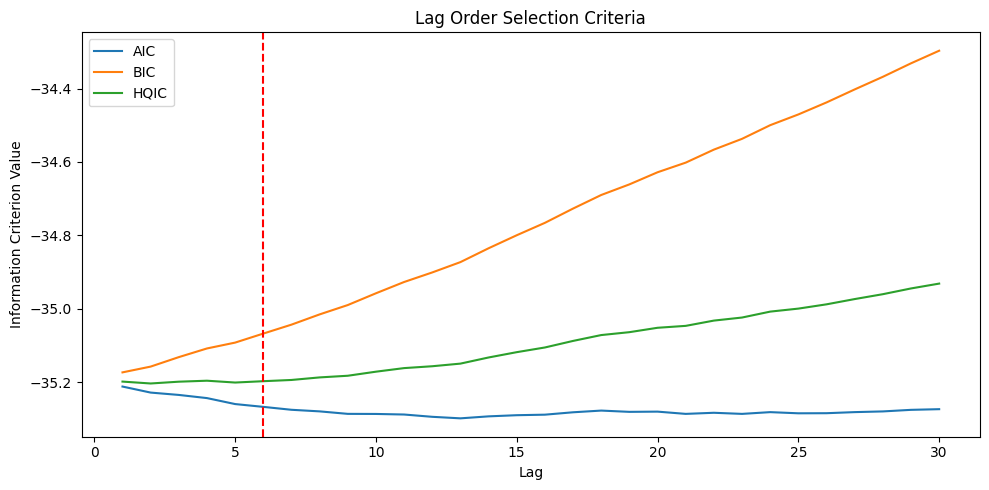

In [14]:
import pandas as pd
from statsmodels.tsa.api import VAR
import matplotlib.pyplot as plt

# Only keep data after 2005-01-01
data_forecast_relevant = data_forecast.loc[data_forecast.index >= '2005-01-01']

# Select relevant columns for VAR model
columns = [
    'VIX Close',
    'WTI Log Daily Change',
    'Information Technology Daily Log Return',
    'Health Care Daily Log Return',
    'Consumer Discretionary Daily Log Return'
]

# Drop missing values (important for VAR)
data_lag = data_forecast_relevant[columns].dropna()

# Fit VAR model to determine optimal lag length
model = VAR(data_lag)

# Perform lag order selection up to a reasonable max (e.g., 30 lags)
lag_selection = model.select_order(maxlags=30)

# Print lag order criteria
print("Lag Order Selection Results:")
print(lag_selection.summary())

# Optional: plot the information criteria
ic_data_forecast = pd.DataFrame({
    'AIC': [model.fit(i).aic for i in range(1, 31)],
    'BIC': [model.fit(i).bic for i in range(1, 31)],
    'HQIC': [model.fit(i).hqic for i in range(1, 31)]
}, index=range(1, 31))

ic_data_forecast.plot(figsize=(10, 5), title='Lag Order Selection Criteria')
plt.xlabel("Lag")
plt.ylabel("Information Criterion Value")
# make a -- line in red color for lag = 6 to show that it is the middle ground between the three criteria
plt.axvline(x=6, color='red', linestyle='--', label='Lag = 6')
plt.grid(False)
plt.tight_layout()
plt.show()


In [ ]:
# Feature Engineering Template for Forecasting Sector Returns (e.g., Information Technology)

import pandas as pd
import numpy as np

# === CONFIGURATION ===
sector = 'Health Care Daily Log Return' #'Information Technology Daily Log Return'
max_lag = 6  # use the lag length based on BIC from your VAR analysis

# === BASE FEATURES ===
#data_forecast['Lag_1_Return'] = data_forecast[sector].shift(1)
#data_forecast['Lag_1_WTI'] = data_forecast['WTI Log Daily Change'].shift(1)
#data_forecast['Lag_1_VIX'] = data_forecast['VIX Close'].shift(1)
#data_forecast['Volume'] = data_forecast['IT Volume']  # Adjust for sector

# === LAGGED FEATURES ===
for lag in range(1, max_lag + 1):
    data_forecast[f'Return_Lag_{lag+1}'] = data_forecast[sector].shift(lag)
    data_forecast[f'WTI_Lag_{lag+1}'] = data_forecast['WTI Log Daily Change'].shift(lag)
    data_forecast[f'VIX_Lag_{lag+1}'] = data_forecast['VIX Close'].shift(lag)

# === ROLLING FEATURES ===
data_forecast['VIX_5D_MA'] = data_forecast['VIX Close'].rolling(5).mean()
data_forecast['WTI_5D_MA'] = data_forecast['WTI Log Daily Change'].rolling(5).mean()
data_forecast['VIX_5D_STD'] = data_forecast['VIX Close'].rolling(5).std()
data_forecast['WTI_5D_STD'] = data_forecast['WTI Log Daily Change'].rolling(5).std()
# also get std for the sector
data_forecast['Return_5D_STD'] = data_forecast[sector].rolling(5).std()

# === INTERACTION FEATURES ===
# These are constructed to capture potential non-linear and conditional effects, e.g., stronger oil impact during high uncertainty.
data_forecast['VIX_x_WTI'] = data_forecast['VIX Close'] * data_forecast['WTI Log Daily Change']
data_forecast['LagReturn_x_VIX'] = data_forecast[sector] * data_forecast['VIX Close']

# === CRISIS PROXY FEATURE ===
data_forecast['High_VIX_Dummy'] = (data_forecast['VIX Close'] > 30).astype(int)

# === TARGET VARIABLE ===
data_forecast['Target'] = data_forecast[sector].shift(-1)  # Next-day return as prediction target

# === FINAL CLEANING ===
data_forecast_model = data_forecast.dropna(subset=['Target'])



In [111]:
# Preview
data_forecast_model[[col for col in data_forecast_model.columns if 'Return' in col or 'WTI' in col or 'VIX' in col]]


,VIX Close,WTI Log Daily Change,Information Technology Daily Log Return,Health Care Daily Log Return,Consumer Discretionary Daily Log Return,Return_Lag_2,WTI_Lag_2,VIX_Lag_2,Return_Lag_3,WTI_Lag_3,...,WTI_Lag_7,VIX_Lag_7,VIX_5D_MA,WTI_5D_MA,VIX_5D_STD,WTI_5D_STD,Return_5D_STD,VIX_x_WTI,LagReturn_x_VIX,High_VIX_Dummy
Date,,,,,,,,,,,,,,,,,,,,,
1993-05-05,12.38,0.002937,0.008621,0.008757,-0.002610,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.036358,0.108407,0
1993-05-06,13.22,0.001465,-0.006131,-0.013274,-0.003120,0.008757,0.002937,12.38,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.019370,-0.175486,0
1993-05-07,13.01,-0.002933,0.008729,-0.004760,-0.000605,-0.013274,0.001465,13.22,0.008757,0.002937,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,-0.038153,-0.061929,0
1993-05-10,13.72,-0.000490,-0.000779,0.001220,0.005332,-0.004760,-0.002933,13.01,-0.013274,0.001465,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,-0.006717,0.016736,0
1993-05-11,13.35,-0.001961,-0.006381,0.002877,0.002706,0.001220,-0.000490,13.72,-0.004760,-0.002933,...,NaN,NaN,13.136,-0.000196,0.495308,0.002412,0.008366,-0.026176,0.038412,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2025-03-24,17.48,0.013625,0.016973,0.007612,0.039868,-0.003041,-0.000438,19.28,0.001124,0.016918,...,0.009088,21.77,19.632,0.004720,1.510933,0.009864,0.003873,0.238172,0.133057,0
2025-03-25,17.15,0.000288,0.002881,-0.013014,0.009723,0.007612,0.013625,17.48,-0.003041,-0.000438,...,0.006062,20.51,18.722,0.005812,1.311000,0.008733,0.007543,0.004937,-0.223188,0
2025-03-26,18.33,0.008170,-0.024933,-0.003659,-0.016790,-0.013014,0.000288,17.15,0.007612,0.013625,...,-0.005173,21.70,18.408,0.007713,1.134447,0.007770,0.007535,0.149762,-0.067071,0


In [112]:
# since it is sampled on IT we want to drop Health Care Daily Log Return, Consumer Discretionary Daily Log Return, HC Volume, CD Volume
#data_forecast_model = data_forecast_model.drop(columns=['Health Care Daily Log Return', 'Consumer Discretionary Daily Log Return', 'HC Volume', 'CD Volume'])
data_forecast_model = data_forecast_model.drop(columns=['Information Technology Daily Log Return', 'Consumer Discretionary Daily Log Return', 'CD Volume', 'IT Volume'])

# also make Uncertainty Regime binary. 0 for normal and 1 for high uncertainty regime
data_forecast_model['Uncertainty Regime'] = data_forecast_model['High_VIX_Dummy'].astype(int)
# drop High VIX Dummy
data_forecast_model = data_forecast_model.drop(columns=['High_VIX_Dummy'])

In [113]:
# remove nan values that have arisen due to the lagging and rolling features
data_forecast_model = data_forecast_model.dropna()

In [114]:
data_forecast_model.columns

Index(['VIX Close', 'WTI Log Daily Change', 'Health Care Daily Log Return',
       'HC Volume', 'Uncertainty Regime', 'Return_Lag_2', 'WTI_Lag_2',
       'VIX_Lag_2', 'Return_Lag_3', 'WTI_Lag_3', 'VIX_Lag_3', 'Return_Lag_4',
       'WTI_Lag_4', 'VIX_Lag_4', 'Return_Lag_5', 'WTI_Lag_5', 'VIX_Lag_5',
       'Return_Lag_6', 'WTI_Lag_6', 'VIX_Lag_6', 'Return_Lag_7', 'WTI_Lag_7',
       'VIX_Lag_7', 'VIX_5D_MA', 'WTI_5D_MA', 'VIX_5D_STD', 'WTI_5D_STD',
       'Return_5D_STD', 'VIX_x_WTI', 'LagReturn_x_VIX', 'Target'],
      dtype='object')

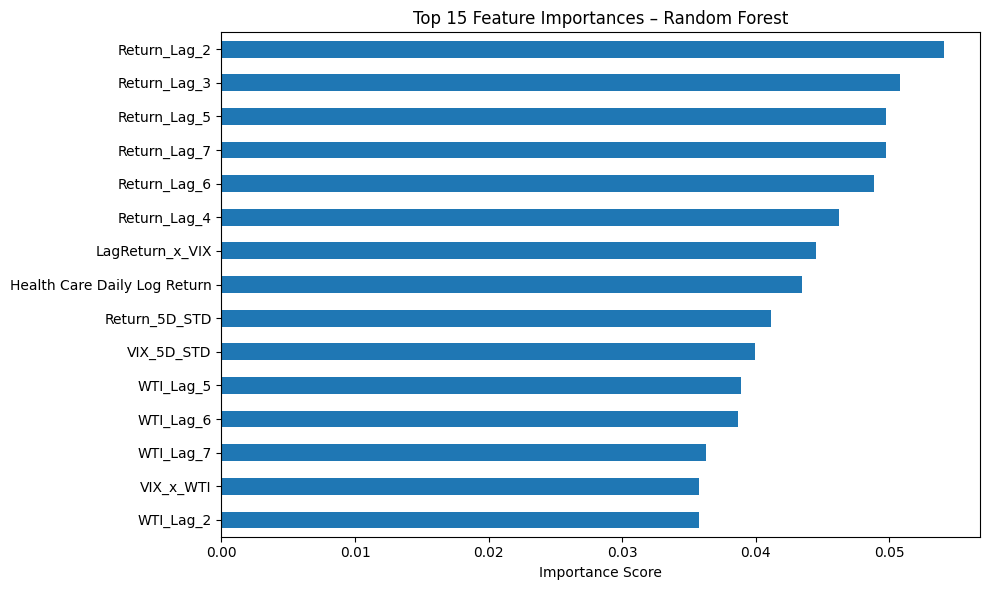

In [115]:
# === RANDOM FOREST FEATURE IMPORTANCE ===
from sklearn.ensemble import RandomForestRegressor
from sklearn.model_selection import train_test_split
from sklearn.metrics import mean_squared_error
import matplotlib.pyplot as plt

# Drop non-feature columns and target
X = data_forecast_model.drop(columns=['Target'])
y = data_forecast_model['Target']

# Train-test split
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, shuffle=False)

# Fit Random Forest
rf = RandomForestRegressor(n_estimators=100, random_state=42)
rf.fit(X_train, y_train)

# Feature importances
importances = pd.Series(rf.feature_importances_, index=X.columns).sort_values(ascending=False)

# Plot
plt.figure(figsize=(10, 6))
importances.head(15).plot(kind='barh')
plt.title("Top 15 Feature Importances – Random Forest")
plt.xlabel("Importance Score")
plt.gca().invert_yaxis()
plt.grid(False)
plt.tight_layout()
plt.show()

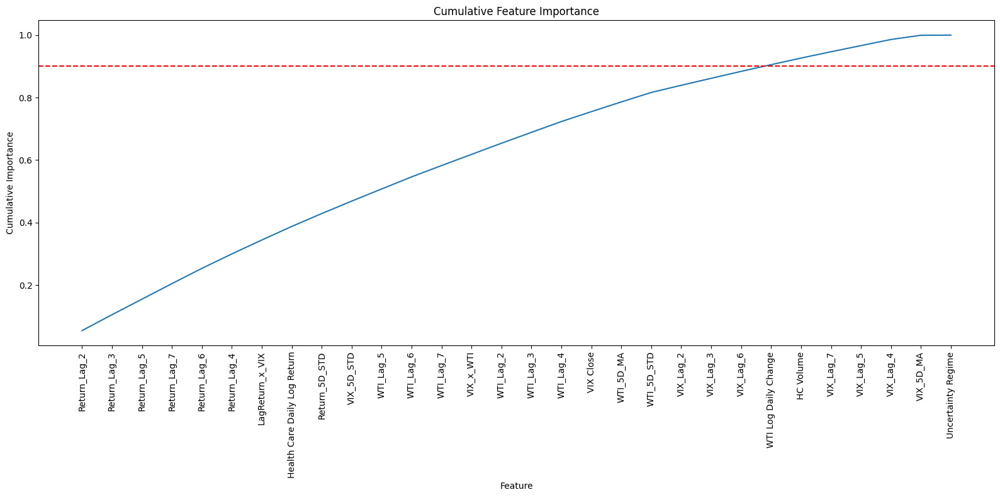

In [116]:
cumulative_importance = importances.cumsum()
important_features = cumulative_importance[cumulative_importance <= 0.90].index

# plot cumulative importance with the threshold of 90%
plt.figure(figsize=(16, 8))
cumulative_importance.plot()
plt.axhline(y=0.90, color='red', linestyle='--')
plt.title("Cumulative Feature Importance")
plt.xlabel("Feature")
plt.ylabel("Cumulative Importance")
# show all feature names on x-axis until the threshold has been achieved
plt.xticks(range(len(importances)), importances.index, rotation=90)
#plt.xticks(range(len(importances)), importances.index, rotation=90)
#plt.xticks(rotation=70)
plt.grid(False)
plt.tight_layout()
plt.show()

In [117]:
important_features

Index(['Return_Lag_2', 'Return_Lag_3', 'Return_Lag_5', 'Return_Lag_7',
       'Return_Lag_6', 'Return_Lag_4', 'LagReturn_x_VIX',
       'Health Care Daily Log Return', 'Return_5D_STD', 'VIX_5D_STD',
       'WTI_Lag_5', 'WTI_Lag_6', 'WTI_Lag_7', 'VIX_x_WTI', 'WTI_Lag_2',
       'WTI_Lag_3', 'WTI_Lag_4', 'VIX Close', 'WTI_5D_MA', 'WTI_5D_STD',
       'VIX_Lag_2', 'VIX_Lag_3', 'VIX_Lag_6'],
      dtype='object')

In [118]:
data_backup = data_forecast_model.copy()

In [119]:
data_forecast_model = data_backup.copy()

In [120]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from statsmodels.tsa.api import VAR
from xgboost import XGBRegressor
from sklearn.model_selection import train_test_split
from sklearn.metrics import mean_absolute_error, mean_squared_error
from sklearn.preprocessing import MinMaxScaler

In [121]:
# define selected features
selected_features = important_features.tolist()
target_column = 'Target'

In [122]:
data_forecast_model

,VIX Close,WTI Log Daily Change,Health Care Daily Log Return,HC Volume,Uncertainty Regime,Return_Lag_2,WTI_Lag_2,VIX_Lag_2,Return_Lag_3,WTI_Lag_3,...,WTI_Lag_7,VIX_Lag_7,VIX_5D_MA,WTI_5D_MA,VIX_5D_STD,WTI_5D_STD,Return_5D_STD,VIX_x_WTI,LagReturn_x_VIX,Target
Date,,,,,,,,,,,,,,,,,,,,,
1993-05-13,14.76,-0.019505,-0.017787,0,0,-0.009661,-0.009367,13.56,0.002877,-0.001961,...,0.002937,12.38,13.680,-0.006851,0.659583,0.007845,0.008428,-0.287901,-0.262540,0.015329
1993-05-14,14.39,-0.014755,0.015329,0,0,-0.017787,-0.019505,14.76,-0.009661,-0.009367,...,0.001465,13.22,13.956,-0.009215,0.594668,0.008145,0.012665,-0.212321,0.220591,0.015649
1993-05-17,14.13,0.000000,0.015649,0,0,0.015329,-0.014755,14.39,-0.017787,-0.019505,...,-0.002933,13.01,14.038,-0.009118,0.582125,0.008278,0.014914,0.000000,0.221116,-0.004636
1993-05-18,14.19,-0.009786,-0.004636,0,0,0.015649,0.000000,14.13,0.015329,-0.014755,...,-0.000490,13.72,14.206,-0.010683,0.437070,0.007264,0.015090,-0.138868,-0.065781,0.012642
1993-05-19,14.29,-0.008838,0.012642,0,0,-0.004636,-0.009786,14.19,0.015649,0.000000,...,-0.001961,13.35,14.352,-0.010577,0.248636,0.007292,0.014897,-0.126297,0.180660,0.008593
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2025-03-24,17.48,0.013625,0.007612,216728900,0,-0.003041,-0.000438,19.28,0.001124,0.016918,...,0.009088,21.77,19.632,0.004720,1.510933,0.009864,0.003873,0.238172,0.133057,-0.013014
2025-03-25,17.15,0.000288,-0.013014,235970800,0,0.007612,0.013625,17.48,-0.003041,-0.000438,...,0.006062,20.51,18.722,0.005812,1.311000,0.008733,0.007543,0.004937,-0.223188,-0.003659
2025-03-26,18.33,0.008170,-0.003659,212845700,0,-0.013014,0.000288,17.15,0.007612,0.013625,...,-0.005173,21.70,18.408,0.007713,1.134447,0.007770,0.007535,0.149762,-0.067071,0.001858


In [123]:
selected_features

['Return_Lag_2',
 'Return_Lag_3',
 'Return_Lag_5',
 'Return_Lag_7',
 'Return_Lag_6',
 'Return_Lag_4',
 'LagReturn_x_VIX',
 'Health Care Daily Log Return',
 'Return_5D_STD',
 'VIX_5D_STD',
 'WTI_Lag_5',
 'WTI_Lag_6',
 'WTI_Lag_7',
 'VIX_x_WTI',
 'WTI_Lag_2',
 'WTI_Lag_3',
 'WTI_Lag_4',
 'VIX Close',
 'WTI_5D_MA',
 'WTI_5D_STD',
 'VIX_Lag_2',
 'VIX_Lag_3',
 'VIX_Lag_6']

In [124]:
# the data that goes from November 1st 2024 to the end, should be extracted from the dataset
#data_forecast_model_trump = data_forecast_model.loc['2024-11-01':]

# the data_forecast_model should stop at the end of October 2024
#data_forecast_model = data_forecast_model.loc[:'2024-10-31']

In [125]:
# Drop NaN values caused by lagging

# Split into train and test sets (80% train, 20% test)
#train_size = int(0.8 * len(data_forecast_model))
#train, test = data_forecast_model.iloc[:train_size], data_forecast_model.iloc[train_size:]
# === SPLIT: Train on recent, test on OOS ===
train_start = "2005-01-01"
train_end = "2019-12-31"
test_start = "2020-01-01"
test_end = "2025-03-31"

train = data_forecast_model.loc[train_start:train_end]
test = data_forecast_model.loc[test_start:test_end]

# ---------------------- SCALE INPUT FEATURES ----------------------
scaler = MinMaxScaler()
train_scaled = scaler.fit_transform(train[selected_features])
test_scaled = scaler.transform(test[selected_features])

# Convert to DataFrame with correct index
train_scaled = pd.DataFrame(train_scaled, columns=selected_features, index=train.index)
test_scaled = pd.DataFrame(test_scaled, columns=selected_features, index=test.index)

# Add back target column
train_scaled[target_column] = train[target_column].values
test_scaled[target_column] = test[target_column].values

In [126]:
# ---------------------- APPLY LOG TRANSFORMATION TO TARGET ----------------------
#train[target_column] = np.log1p(train[target_column])  # log(1 + x) to avoid log(0)
#test[target_column] = np.log1p(test[target_column]) 


## ---------------------- SCALE INPUT FEATURES ----------------------
#scaler = MinMaxScaler()
#train_scaled = scaler.fit_transform(train[selected_features])
#test_scaled = scaler.transform(test[selected_features])

## Convert back to DataFrame
#train_scaled = pd.DataFrame(train_scaled, columns=selected_features, index=train.index)
#test_scaled = pd.DataFrame(test_scaled, columns=selected_features, index=test.index)

## Add back log-transformed target column
#train_scaled[target_column] = train[target_column]
#test_scaled[target_column] = test[target_column]

Best parameters are:

In [127]:
import xgboost as xgb
params = {
    "objective": "reg:squarederror",
    "eta": 0.15,
    "max_depth": 50,
    "min_child_weight": 7,
    "gamma": 0,
    "subsample": 0.8,
    "colsample_bytree": 0.8,
    "eval_metric": "rmse",
    "seed": 42
}
dtrain = xgb.DMatrix(train_scaled[selected_features], label=train_scaled[target_column])
dtest = xgb.DMatrix(test_scaled[selected_features], label=test_scaled[target_column])

num_boost_round = 100
model = xgb.train(params, dtrain, num_boost_round=num_boost_round)

y_pred = model.predict(dtest)
y_test = test_scaled[target_column].values

# Inverse log transformation
#y_pred = np.expm1(y_pred)  # exp(x) - 1 to revert log(1 + x)
#y_test = np.expm1(test_scaled[target_column].values)  # exp(x) - 1 to revert log(1 + x)
# Calculate MAE and RMSE
mae = mean_absolute_error(y_test, y_pred)
rmse = np.sqrt(mean_squared_error(y_test, y_pred))
print(f"MAE: {mae:.4f}")
print(f"RMSE: {rmse:.4f}")

MAE: 0.0082
RMSE: 0.0121


In [128]:

# Get date index from the original test set
test_index = test.index[-len(y_test):]

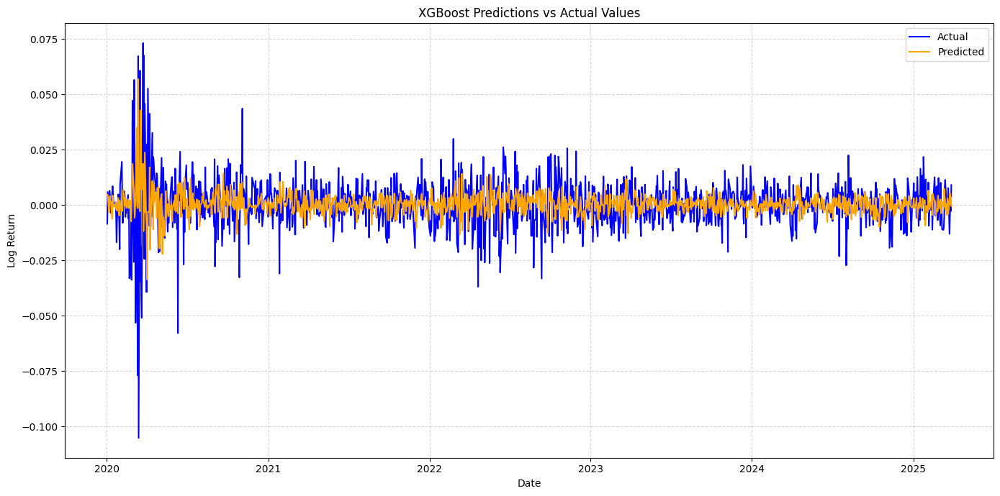

In [129]:
# Plotting the predictions vs actual values
plt.figure(figsize=(14, 7))
plt.plot(test_index, y_test, label='Actual', color='blue')
plt.plot(test_index, y_pred, label='Predicted', color='orange')
plt.title("XGBoost Predictions vs Actual Values")
plt.xlabel("Date")
plt.ylabel("Log Return")
plt.legend()
plt.grid(True, linestyle='--', alpha=0.5)
plt.tight_layout()
plt.show()

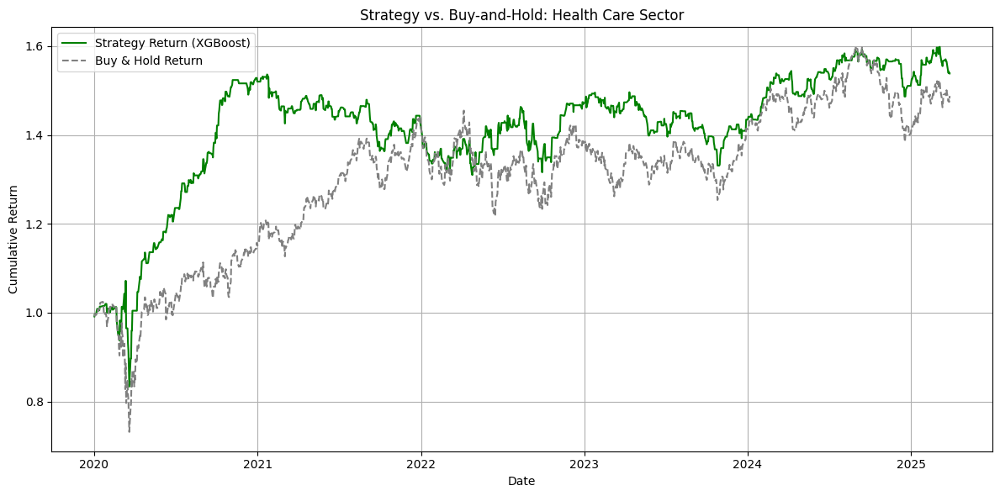

In [130]:
# ---------------------- STRATEGY SIMULATION ----------------------
#signal = np.where(y_pred > 0, 1, -1)
signal = np.where(y_pred > 0, 1, 0)  # Only buy when positive, otherwise stay out

strategy_returns = signal * y_test  # y_test is already a NumPy array

# Cumulative return using log returns -> exp of cumsum
cumulative_strategy = np.exp(np.cumsum(strategy_returns))
cumulative_bh = np.exp(np.cumsum(y_test))


plt.figure(figsize=(12, 6))
plt.plot(test_index, cumulative_strategy, label="Strategy Return (XGBoost)", color="green")
plt.plot(test_index, cumulative_bh, label="Buy & Hold Return", color="gray", linestyle="--")
plt.xlabel("Date")
plt.ylabel("Cumulative Return")
plt.title("Strategy vs. Buy-and-Hold: Health Care Sector")
plt.legend()
plt.grid(True)
plt.tight_layout()
plt.show()


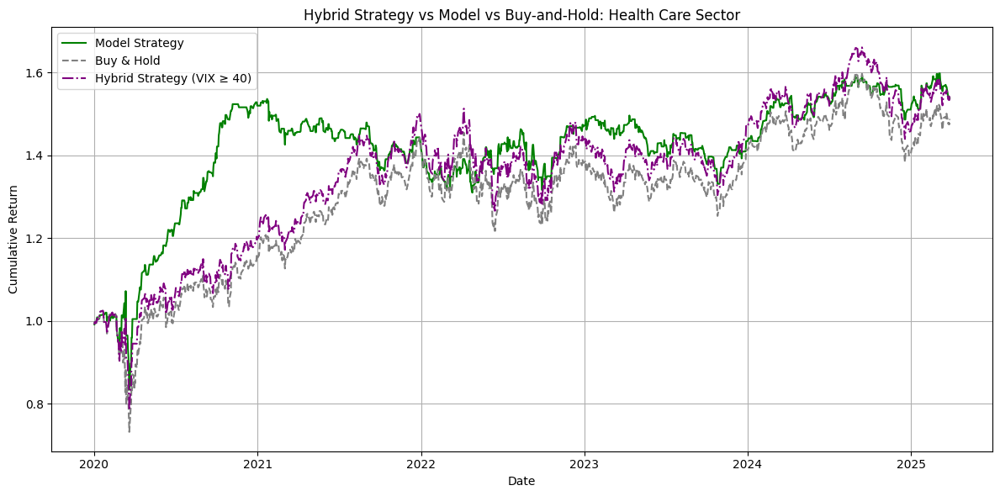

In [131]:
# ---------------------- HYBRID STRATEGY ----------------------

# Extract VIX values for the test period
vix_test = test["VIX Close"].values

# Hybrid strategy signal
hybrid_signal = np.where(vix_test >= 40, signal, 1)  # use model when VIX is high, otherwise hold

# Hybrid strategy returns
hybrid_returns = hybrid_signal * y_test

# Cumulative return using log returns
cumulative_hybrid = np.exp(np.cumsum(hybrid_returns))

# Plot all strategies
plt.figure(figsize=(12, 6))
plt.plot(test_index, cumulative_strategy, label="Model Strategy", color="green", linestyle="-")
plt.plot(test_index, cumulative_bh, label="Buy & Hold", color="gray", linestyle="--")
plt.plot(test_index, cumulative_hybrid, label="Hybrid Strategy (VIX ≥ 40)", color="purple", linestyle="-.")
plt.xlabel("Date")
plt.ylabel("Cumulative Return")
plt.title("Hybrid Strategy vs Model vs Buy-and-Hold: Health Care Sector")
plt.legend()
plt.grid(True)
plt.tight_layout()
plt.show()


In [785]:
# Calculate average annual return and volatility
trading_days_per_year = 252
annualized_return_strategy = np.mean(strategy_returns) * trading_days_per_year
annualized_volatility_strategy = np.std(strategy_returns) * np.sqrt(trading_days_per_year)

annualizd_return_hybrid = np.mean(hybrid_returns) * trading_days_per_year
annualized_volatility_hybrid = np.std(hybrid_returns) * np.sqrt(trading_days_per_year)

annualized_return_bh = np.mean(y_test) * trading_days_per_year
annualized_volatility_bh = np.std(y_test) * np.sqrt(trading_days_per_year)

print("\nAnnualized Performance:")
print(f"Strategy - Return: {annualized_return_strategy:.4f}, Volatility: {annualized_volatility_strategy:.4f}")
print(f"Buy & Hold - Return: {annualized_return_bh:.4f}, Volatility: {annualized_volatility_bh:.4f}")
#print(f"Hybrid Strategy - Return: {annualizd_return_hybrid:.4f}, Volatility: {annualized_volatility_hybrid:.4f}")



Annualized Performance:
Strategy - Return: 0.2042, Volatility: 0.1628
Buy & Hold - Return: 0.1381, Volatility: 0.2457


In [730]:
# statistical significance testing between the three to determine whether the hybrid strategy is statistically significantly better than the buy and hold
from scipy.stats import ttest_rel
# Calculate daily returns
strategy_daily_returns = np.diff(np.log(cumulative_strategy))
bh_daily_returns = np.diff(np.log(cumulative_bh))
hybrid_daily_returns = np.diff(np.log(cumulative_hybrid))
# Perform paired t-tests
t_stat_strategy_bh, p_value_strategy_bh = ttest_rel(strategy_daily_returns, bh_daily_returns)
t_stat_hybrid_bh, p_value_hybrid_bh = ttest_rel(hybrid_daily_returns, bh_daily_returns)
t_stat_hybrid_strategy, p_value_hybrid_strategy = ttest_rel(hybrid_daily_returns, strategy_daily_returns)
print("\nStatistical Significance Testing:")
print(f"Strategy vs Buy & Hold: t-stat={t_stat_strategy_bh:.4f}, p-value={p_value_strategy_bh:.4f}")
print(f"Hybrid vs Buy & Hold: t-stat={t_stat_hybrid_bh:.4f}, p-value={p_value_hybrid_bh:.4f}")
print(f"Hybrid vs Strategy: t-stat={t_stat_hybrid_strategy:.4f}, p-value={p_value_hybrid_strategy:.4f}")



Statistical Significance Testing:
Strategy vs Buy & Hold: t-stat=-0.5563, p-value=0.5781
Hybrid vs Buy & Hold: t-stat=0.4132, p-value=0.6795
Hybrid vs Strategy: t-stat=0.8871, p-value=0.3752


In [447]:
# test it on an out-of-sample dataset
# load the out-of-sample data
data_out_of_sample = pd.read_csv("ProcessedData_2025.csv")
data_forecast_oos = data_out_of_sample.copy()
# make Date the index
data_forecast_oos['Date'] = pd.to_datetime(data_forecast_oos['Date'])
data_forecast_oos.set_index('Date', inplace=True)
# for now we will only use VIX Close, WTI Spot Price, IT Adj Close_Return, HC Adj Close_Return AND CD Adj Close_Return, IT Volume, HD Volume, CD Volume
data_forecast_oos = data_forecast_oos[['VIX Close', 'WTI Log Daily Change', 'IT_Log_Return', 'HC_Log_Return', 'CD_Log_Return', 'IT Volume', 'HC Volume', 'CD Volume']]
# rename VIX Close to VIX, IT Adj Close_Return to IT Daily Return, HC Adj Close_Return to HC Daily Return, CD Adj Close_Return to CD Daily Return
data_forecast_oos.rename(columns={'VIX Close': 'VIX'})#, 'IT_Return': 'IT Daily Return', 'HC Adj Close_Return': 'HC Daily Return', 'CD Adj Close_Return': 'CD Daily Return'}, inplace=True)
# remame HC Daily Return to Health Care Daily Return, CD Daaily Return to Consumer Discretionary Daily Return, IT Daily Return to Information Technology Daily Return
data_forecast_oos.rename(columns={'HC_Log_Return': 'Health Care Daily Log Return', 'CD_Log_Return': 'Consumer Discretionary Daily Log Return', 'IT_Log_Return': 'Information Technology Daily Log Return'}, inplace=True)
data_forecast_oos.head()

# Define sectors
sectors = ['Health Care Daily Log Return', 'Information Technology Daily Log Return', 'Consumer Discretionary Daily Log Return']

# Define event-based high uncertainty periods
high_uncertainty_periods = [
    ("Asian Financial Crisis", "1997-07-01", "1998-10-01"),
    ("Dot-Com Bubble", "2000-03-01", "2002-10-01"),
    ("Post-9/11 Market Shock", "2001-09-11", "2001-12-31"),
    ("Iraq War", "2003-10-01", "2003-12-31"),
    ("Global Financial Crisis", "2007-07-01", "2009-03-01"),
    ("European Debt Crisis", "2010-05-01", "2012-06-01"),
    ("US Debt Ceiling Crisis", "2011-07-01", "2011-08-31"),
    ("China Market Crash & Oil Collapse", "2015-06-01", "2016-03-01"),
    ("COVID-19 Pandemic", "2020-03-01", "2021-06-01"),
    ("2022 Inflation & Rate Hikes", "2022-01-01", "2023-06-01")
]

# Convert dates to datetime format
data_forecast_oos.index = pd.to_datetime(data_forecast_oos.index)
 # Assign "High Uncertainty" based on event classification
data_forecast_oos["Uncertainty Regime"] = "Normal Uncertainty"  # Default category
for _, start, end in high_uncertainty_periods:
    mask = (data_forecast_oos.index >= pd.to_datetime(start)) & (data_forecast_oos.index <= pd.to_datetime(end))
    data_forecast_oos.loc[mask, "Uncertainty Regime"] = "High Uncertainty"
# Feature Engineering Template for Forecasting Sector Returns (e.g., Information Technology)

import pandas as pd
import numpy as np

# === CONFIGURATION ===
sector = 'Health Care Daily Log Return'#'Information Technology Daily Log Return'
max_lag = 3  # use the lag length based on BIC from your VAR analysis

# === BASE FEATURES ===
data_forecast_oos['Lag_1_Return'] = data_forecast_oos[sector].shift(1)
data_forecast_oos['Lag_1_WTI'] = data_forecast_oos['WTI Log Daily Change'].shift(1)
data_forecast_oos['Lag_1_VIX'] = data_forecast_oos['VIX Close'].shift(1)
data_forecast_oos['Volume'] = data_forecast_oos['IT Volume']  # Adjust for sector

# === LAGGED FEATURES ===
for lag in range(2, max_lag + 1):
    data_forecast_oos[f'Return_Lag_{lag}'] = data_forecast_oos[sector].shift(lag)
    data_forecast_oos[f'WTI_Lag_{lag}'] = data_forecast_oos['WTI Log Daily Change'].shift(lag)
    data_forecast_oos[f'VIX_Lag_{lag}'] = data_forecast_oos['VIX Close'].shift(lag)

# === ROLLING FEATURES ===
data_forecast_oos['VIX_5D_MA'] = data_forecast_oos['VIX Close'].rolling(5).mean()
data_forecast_oos['WTI_5D_MA'] = data_forecast_oos['WTI Log Daily Change'].rolling(5).mean()
#data_forecast_oos['VIX_5D_STD'] = data_forecast_oos['VIX Close'].rolling(5).std()
#data_forecast_oos['WTI_5D_STD'] = data_forecast_oos['WTI Log Daily Change'].rolling(5).std()
# === INTERACTION FEATURES ===
# These are constructed to capture potential non-linear and conditional effects, e.g., stronger oil impact during high uncertainty.
data_forecast_oos['VIX_x_WTI'] = data_forecast_oos['VIX Close'] * data_forecast_oos['WTI Log Daily Change']
data_forecast_oos['LagReturn_x_VIX'] = data_forecast_oos['Lag_1_Return'] * data_forecast_oos['VIX Close']

# === CRISIS PROXY FEATURE ===
data_forecast_oos['High_VIX_Dummy'] = (data_forecast_oos['VIX Close'] > 40).astype(int)

# # === TARGET VARIABLE ===
data_forecast_oos['Target'] = data_forecast_oos[sector].shift(-1)  # Next-day return as prediction target

# # === FINAL CLEANING ===
data_forecast_oos_model = data_forecast_oos.dropna(subset=['Target'])

In [448]:
# combine data_forecast_oos_model with data_forecast_model_trump. Drop the duplicate rows
data_forecast_oos_model = pd.concat([data_forecast_oos_model, data_forecast_model_trump], axis=0)
data_forecast_oos_model = data_forecast_oos_model.drop_duplicates()

In [449]:
# sort the data by date
data_forecast_oos_model = data_forecast_oos_model.sort_index()

In [450]:

# Preview
data_forecast_oos_model[[col for col in data_forecast_oos_model.columns if 'Return' in col or 'WTI' in col or 'VIX' in col]].tail(5)

,VIX Close,WTI Log Daily Change,Information Technology Daily Log Return,Health Care Daily Log Return,Consumer Discretionary Daily Log Return,Lag_1_Return,Lag_1_WTI,Lag_1_VIX,Return_Lag_2,WTI_Lag_2,VIX_Lag_2,Return_Lag_3,WTI_Lag_3,VIX_Lag_3,VIX_5D_MA,WTI_5D_MA,VIX_x_WTI,LagReturn_x_VIX,High_VIX_Dummy
Date,,,,,,,,,,,,,,,,,,,
2025-03-24,17.48,0.013625,0.016973,0.007612,0.039868,-0.003041,-0.000438,19.28,0.001124,0.016918,19.80,0.000152,-0.001334,19.90,19.632,0.004720,0.238172,-0.053161,0.0
2025-03-25,17.15,0.000288,0.002881,-0.013014,0.009723,0.007612,0.013625,17.48,-0.003041,-0.000438,19.28,0.001124,0.016918,19.80,18.722,0.005812,0.004937,0.130545,0.0
2025-03-26,18.33,0.008170,-0.024933,-0.003659,-0.016790,-0.013014,0.000288,17.15,0.007612,0.013625,17.48,-0.003041,-0.000438,19.28,18.408,0.007713,0.149762,-0.238545,0.0
2025-03-27,18.69,0.003563,-0.007518,0.001858,0.000920,-0.003659,0.008170,18.33,-0.013014,0.000288,17.15,0.007612,0.013625,17.48,18.186,0.005042,0.066584,-0.068388,0.0
2025-03-28,21.65,-0.007998,-0.024588,-0.002770,-0.033226,0.001858,0.003563,18.69,-0.003659,0.008170,18.33,-0.013014,0.000288,17.15,18.660,0.003530,-0.173151,0.040222,0.0


In [451]:
# since it is sampled on IT we want to drop Health Care Daily Log Return, Consumer Discretionary Daily Log Return, HC Volume, CD Volume
#data_forecast_oos_model = data_forecast_oos_model.drop(columns=['Health Care Daily Log Return', 'Consumer Discretionary Daily Log Return', 'HC Volume', 'CD Volume'])

# also make Uncertainty Regime binary. 0 for normal and 1 for high uncertainty regime
#data_forecast_oos_model['Uncertainty Regime'] = data_forecast_oos_model['High_VIX_Dummy'].astype(int)
# drop High VIX Dummy
data_forecast_oos_model = data_forecast_oos_model.drop(columns=['High_VIX_Dummy'])
# remove nan values that have arisen due to the lagging and rolling features
data_forecast_oos_model = data_forecast_oos_model.dropna()

In [452]:
data_forecast_model.tail(1)

,VIX Close,WTI Log Daily Change,Health Care Daily Log Return,HC Volume,Uncertainty Regime,Lag_1_Return,Lag_1_WTI,Lag_1_VIX,Volume,Return_Lag_2,WTI_Lag_2,VIX_Lag_2,Return_Lag_3,WTI_Lag_3,VIX_Lag_3,VIX_5D_MA,WTI_5D_MA,VIX_x_WTI,LagReturn_x_VIX,Target
Date,,,,,,,,,,,,,,,,,,,,
2024-10-31,23.16,0.009676,-0.008147,233734800,0,-0.001882,0.02097,20.35,1002167400,-0.002882,-0.002516,19.34,0.001281,-0.062597,19.8,20.596,-0.002854,0.224093,-0.043581,0.005925


In [416]:
# # data_forecast_model should end at 2025-10-09
# data_forecast_model = data_forecast_model.loc[:"2025-01-09"]

In [417]:
# data_forecast_oos_model should not start until 2025-02-08
#data_forecast_oos_model = data_forecast_oos_model.loc["2025-01-10":]

In [482]:
# data_forecast_model should start at 2010-01-01
data_forecast_model = data_forecast_model.loc["2021-01-01":"2024-10-31"]

In [460]:
important_features

Index(['Health Care Daily Log Return', 'Return_Lag_2', 'Return_Lag_3',
       'LagReturn_x_VIX', 'Lag_1_WTI', 'WTI_Lag_3', 'WTI_Lag_2', 'WTI_5D_MA',
       'Lag_1_Return', 'VIX Close', 'VIX_x_WTI', 'VIX_Lag_3', 'VIX_Lag_2',
       'Lag_1_VIX'],
      dtype='object')

In [ ]:
# ---------------------- SETTINGS ----------------------
target_column = 'Health Care Daily Log Return' # 'Information Technology Daily Log Return'
selected_features = important_features.tolist()

# ---------------------- DATA SPLIT ----------------------
train = data_forecast_model.copy()  # Use full in-sample data for training

# ---------------------- SCALE FEATURES ----------------------
scaler = MinMaxScaler()
train_scaled = scaler.fit_transform(train[selected_features])
train_scaled = pd.DataFrame(train_scaled, columns=selected_features, index=train.index)
train_scaled[target_column] = train[target_column]

X_train = train_scaled[selected_features]
y_train = train_scaled[target_column]

# ---------------------- MANUAL XGBOOST SETUP ----------------------
import xgboost as xgb
params = {
    "objective": "reg:squarederror",
    "eta": 0.15,
    "max_depth": 10,
    "min_child_weight": 3,
    "gamma": 0.001,
    "subsample": 0.8,
    "colsample_bytree": 0.8,
    "eval_metric": "rmse",
    "seed": 42
}

dtrain = xgb.DMatrix(X_train, label=y_train)
model = xgb.train(params, dtrain, num_boost_round=100)

# ---------------------- OUT-OF-SAMPLE PREDICTION ----------------------
X_oos = data_forecast_oos_model[selected_features]
y_oos = data_forecast_oos_model[target_column]

X_oos_scaled = scaler.transform(X_oos)
X_oos_scaled = pd.DataFrame(X_oos_scaled, columns=selected_features, index=data_forecast_oos_model.index)
dtest_oos = xgb.DMatrix(X_oos_scaled)

y_pred_oos = model.predict(dtest_oos)

mae = mean_absolute_error(y_oos, y_pred_oos)
rmse = np.sqrt(mean_squared_error(y_oos, y_pred_oos))

print("\nXGBoost OOS Model Metrics:")
print(f"MAE: {mae:.4f}")
print(f"RMSE: {rmse:.4f}")


XGBoost OOS Model Metrics:
MAE: 0.0081
RMSE: 0.0094


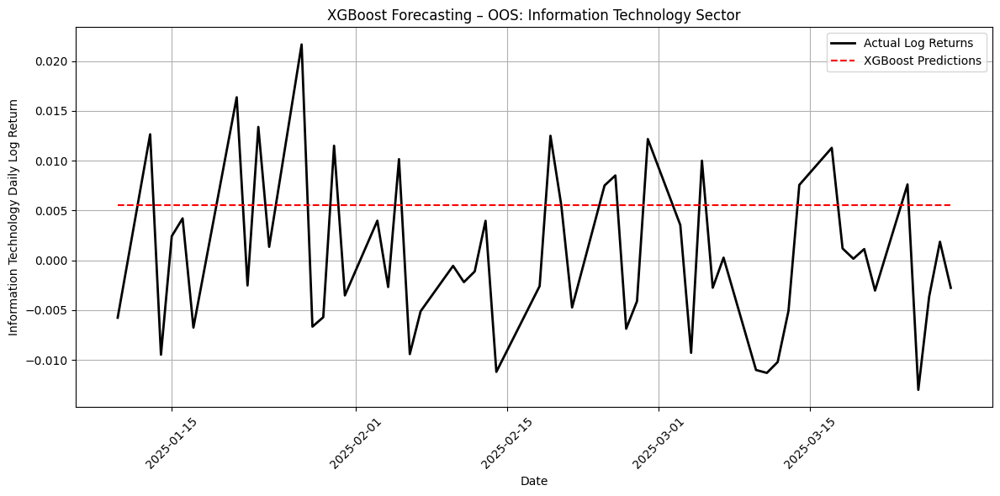

In [490]:
# ---------------------- PLOT RESULTS ----------------------
plt.figure(figsize=(12, 6))
plt.plot(y_oos.index, y_oos, label="Actual Log Returns", color="black", linewidth=2)
plt.plot(y_oos.index, y_pred_oos, label="XGBoost Predictions", linestyle="dashed", color="red")
plt.xticks(rotation=45)
plt.xlabel("Date")
plt.ylabel("Information Technology Daily Log Return")
plt.title("XGBoost Forecasting – OOS: Information Technology Sector")
plt.legend()
plt.grid()
plt.tight_layout()
plt.show()


OOS Annualized Performance:
Strategy - Return: 0.0291, Volatility: 0.0589
Buy & Hold - Return: 0.0291, Volatility: 0.0589


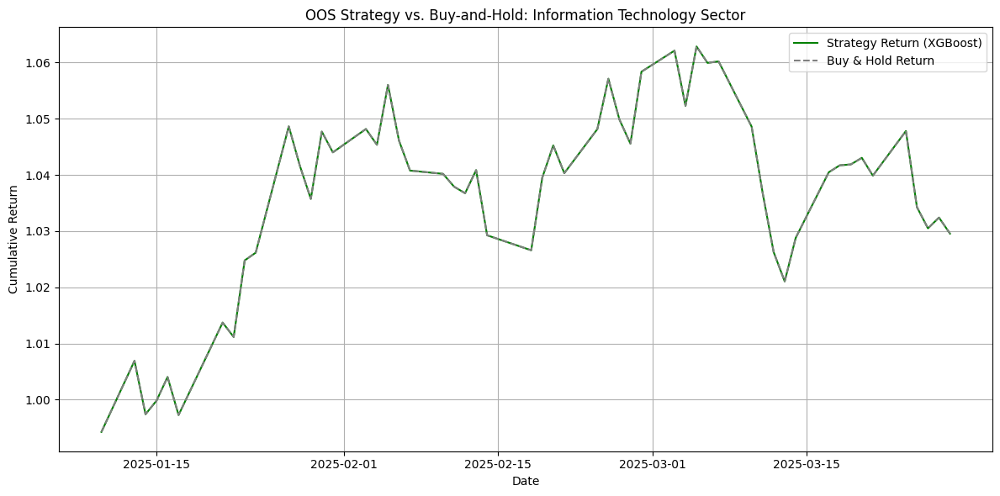

In [491]:
# ---------------------- STRATEGY SIMULATION ----------------------
signal = np.where(y_pred_oos > 0, 1, 0)  # Buy only if positive prediction
strategy_returns = signal * y_oos.values

cumulative_strategy = np.exp(np.cumsum(strategy_returns))
cumulative_bh = np.exp(np.cumsum(y_oos.values))
# lenght of test period instead
trading_days_per_year = len(strategy_returns) #252
annualized_return_strategy = np.mean(strategy_returns) * trading_days_per_year
annualized_volatility_strategy = np.std(strategy_returns) * np.sqrt(trading_days_per_year)
annualized_return_bh = np.mean(y_oos) * trading_days_per_year
annualized_volatility_bh = np.std(y_oos) * np.sqrt(trading_days_per_year)

print("\nOOS Annualized Performance:")
print(f"Strategy - Return: {annualized_return_strategy:.4f}, Volatility: {annualized_volatility_strategy:.4f}")
print(f"Buy & Hold - Return: {annualized_return_bh:.4f}, Volatility: {annualized_volatility_bh:.4f}")

plt.figure(figsize=(12, 6))
plt.plot(y_oos.index, cumulative_strategy, label="Strategy Return (XGBoost)", color="green")
plt.plot(y_oos.index, cumulative_bh, label="Buy & Hold Return", color="gray", linestyle="--")
plt.xlabel("Date")
plt.ylabel("Cumulative Return")
plt.title("OOS Strategy vs. Buy-and-Hold: Information Technology Sector")
plt.legend()
plt.grid()
plt.tight_layout()
plt.show()

In [287]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from xgboost import XGBRegressor
from sklearn.metrics import mean_absolute_error, mean_squared_error
from sklearn.preprocessing import MinMaxScaler
from sklearn.model_selection import TimeSeriesSplit, cross_val_score
import optuna


# ---------------------- PREPARE DATA ----------------------
# Define train and test sets
X_train, X_test = train_scaled[selected_features], test_scaled[selected_features]
y_train, y_test = train[target_column], test[target_column]  # <- use original, not the scaled one


# ---------------------- OPTUNA HYPERPARAMETER TUNING ----------------------
# ---------------------- OPTUNA HYPERPARAMETER TUNING ----------------------
ts_cv = TimeSeriesSplit(n_splits=5)

def objective(trial):
    params = {
        "n_estimators": trial.suggest_int("n_estimators", 50, 300),
        "learning_rate": trial.suggest_float("learning_rate", 0.001, 0.1, log=True),
        "max_depth": trial.suggest_int("max_depth", 3, 8),
        "subsample": trial.suggest_float("subsample", 0.6, 1.0),
        "colsample_bytree": trial.suggest_float("colsample_bytree", 0.6, 1.0),
        "reg_alpha": trial.suggest_float("reg_alpha", 0.0, 10.0),
        "reg_lambda": trial.suggest_float("reg_lambda", 0.0, 10.0),
    }

    model = XGBRegressor(**params, random_state=42)
    scores = cross_val_score(model, X_train, y_train, 
                             scoring='neg_root_mean_squared_error', 
                             cv=ts_cv)
    return -1 * np.mean(scores)

study = optuna.create_study(direction="minimize")
study.optimize(objective, n_trials=100)

best_params = study.best_params
print("Best Hyperparameters:", best_params)


[I 2025-04-07 22:01:54,673] A new study created in memory with name: no-name-8ca3b45c-f5d7-4125-b25a-70d7318b702c
[I 2025-04-07 22:01:55,041] Trial 0 finished with value: 0.016479525159828423 and parameters: {'n_estimators': 53, 'learning_rate': 0.03581948132887296, 'max_depth': 7, 'subsample': 0.612565087964313, 'colsample_bytree': 0.6518008667064178, 'reg_alpha': 3.910596282790195, 'reg_lambda': 6.669794104372219}. Best is trial 0 with value: 0.016479525159828423.
[I 2025-04-07 22:01:55,818] Trial 1 finished with value: 0.016479525159828423 and parameters: {'n_estimators': 185, 'learning_rate': 0.020826937388907032, 'max_depth': 6, 'subsample': 0.9849245324452112, 'colsample_bytree': 0.7190908783765271, 'reg_alpha': 5.238358997667298, 'reg_lambda': 1.3494228942230746}. Best is trial 0 with value: 0.016479525159828423.
[I 2025-04-07 22:01:59,297] Trial 2 finished with value: 0.017772902379754787 and parameters: {'n_estimators': 203, 'learning_rate': 0.08641409080712338, 'max_depth': 7

Best Hyperparameters: {'n_estimators': 118, 'learning_rate': 0.003685906625295339, 'max_depth': 4, 'subsample': 0.8201383012988753, 'colsample_bytree': 0.8304875020684475, 'reg_alpha': 2.041939432478322, 'reg_lambda': 3.0493824199301915}


In [294]:
# ---------------------- TRAIN FINAL MODEL ----------------------
best_xgb_model = XGBRegressor(**best_params, random_state=42)
best_xgb_model.fit(X_train, y_train)

# ---------------------- PREDICT AND EVALUATE ----------------------
# xgb_predictions = best_xgb_model.predict(X_test) but also we want to transform the predictions back to the original scale
xgb_predictions = best_xgb_model.predict(X_test)
# Inverse log transformation
xgb_predictions = np.expm1(xgb_predictions)  # exp(x) - 1 to revert log(1 + x)
# Inverse log transformation for y_test as well
y_test = np.expm1(y_test)  # exp(x) - 1 to revert log(1 + x)
# Calculate metrics

xgb_mae = mean_absolute_error(y_test, xgb_predictions)
xgb_rmse = np.sqrt(mean_squared_error(y_test, xgb_predictions))

print("\nXGBoost Model Metrics:")
print(f"MAE: {xgb_mae:.4f}")
print(f"RMSE: {xgb_rmse:.4f}")


XGBoost Model Metrics:
MAE: 0.0125
RMSE: 0.0163


In [295]:
# ---------------------- GRID SEARCH FROM KAGGLE ----------------------
def mysearch(X_train, y_train, X_val, y_val, param, param1, param2=None, estimator=XGBRegressor, score=mean_absolute_error):
    best_score = 1e10
    best_param = {**param}
    para = {**param}
    key1 = list(param1.keys())[0]
    if param2 is not None:
        key2 = list(param2.keys())[0]
        for parama in param1[key1]:
            for paramb in param2[key2]:
                para[key1] = parama
                para[key2] = paramb
                est = estimator(**para)
                est.fit(X_train, y_train)
                y_pred = est.predict(X_val)
                current_score = score(y_pred, y_val)
                if current_score < best_score:
                    best_score = current_score
                    best_param[key1] = parama
                    best_param[key2] = paramb
    else:
        for parama in param1[key1]:
            para[key1] = parama
            est = estimator(**para)
            est.fit(X_train, y_train)
            y_pred = est.predict(X_val)
            current_score = score(y_pred, y_val)
            if current_score < best_score:
                best_score = current_score
                best_param[key1] = parama
    return best_score, best_param

# ---------------------- RUN SEARCH ----------------------
val_split = int(0.8 * len(X_train))
X_tr, X_val = X_train[:val_split], X_train[val_split:]
y_tr, y_val = y_train[:val_split], y_train[val_split:]

base_param = {"random_state": 42}
param1 = {"n_estimators": [50, 100, 200]}
param2 = {"learning_rate": [0.001, 0.01, 0.05, 0.1]}

_, best_param = mysearch(X_tr, y_tr, X_val, y_val, base_param, param1, param2, XGBRegressor, mean_absolute_error)
print("Best Parameters:", best_param)

Best Parameters: {'random_state': 42, 'n_estimators': 50, 'learning_rate': 0.01}


In [296]:
# ---------------------- TRAIN FINAL MODEL ----------------------
final_model = XGBRegressor(**best_param)
final_model.fit(X_train, y_train)

# ---------------------- PREDICT AND EVALUATE ----------------------
xgb_predictions = final_model.predict(X_test)
# Inverse log transformation
xgb_predictions = np.expm1(xgb_predictions)  # exp(x) - 1 to revert log(1 + x)

xgb_mae = mean_absolute_error(y_test, xgb_predictions)
xgb_rmse = np.sqrt(mean_squared_error(y_test, xgb_predictions))

print("\nXGBoost Model Metrics:")
print(f"MAE: {xgb_mae:.4f}")
print(f"RMSE: {xgb_rmse:.4f}")


XGBoost Model Metrics:
MAE: 0.0125
RMSE: 0.0163


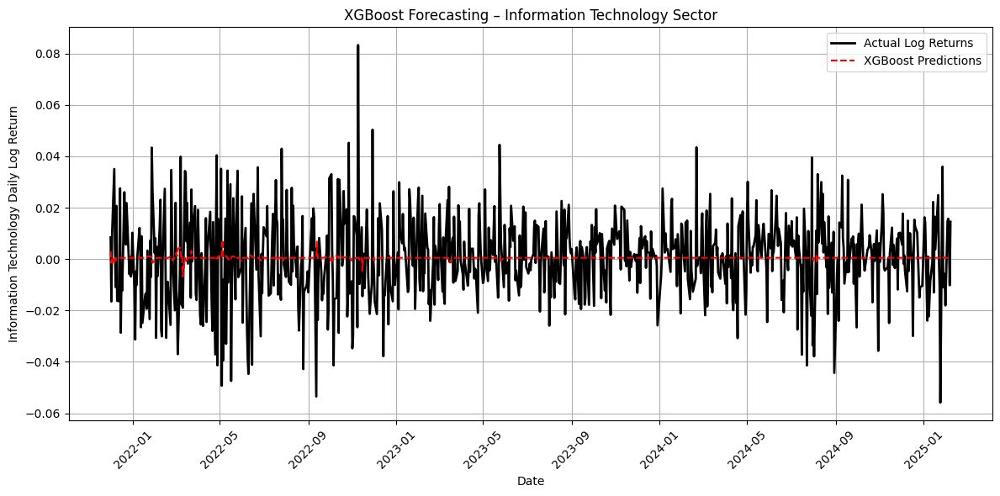

In [297]:
# ---------------------- PLOT RESULTS ----------------------
plt.figure(figsize=(12, 6))
plt.plot(data_forecast_model.index[train_size:], data_forecast_model[target_column].iloc[train_size:], label="Actual Log Returns", color="black", linewidth=2)
plt.plot(data_forecast_model.index[train_size:], xgb_predictions, label="XGBoost Predictions", linestyle="dashed", color="red")

plt.xticks(rotation=45)
plt.xlabel("Date")
plt.ylabel("Information Technology Daily Log Return")
plt.title("XGBoost Forecasting – Information Technology Sector")
plt.legend()
plt.grid()
plt.tight_layout()
plt.show()


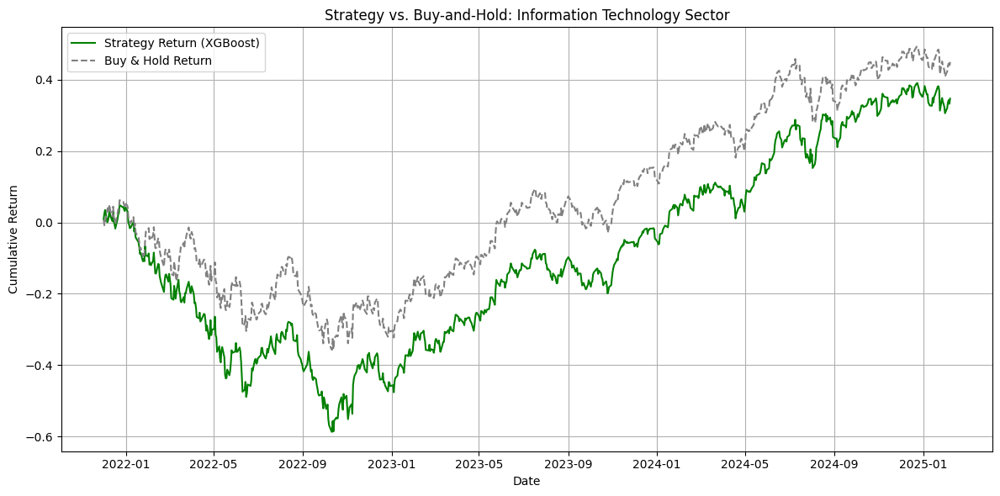

In [292]:
# ---------------------- STRATEGY SIMULATION ----------------------
signal = np.where(xgb_predictions > 0, 1, -1)
strategy_returns = signal * y_test.values
cumulative_strategy = np.cumsum(strategy_returns)
cumulative_bh = np.cumsum(y_test.values)

plt.figure(figsize=(12, 6))
plt.plot(y_test.index, cumulative_strategy, label="Strategy Return (XGBoost)", color="green")
plt.plot(y_test.index, cumulative_bh, label="Buy & Hold Return", color="gray", linestyle="--")
plt.xlabel("Date")
plt.ylabel("Cumulative Return")
plt.title("Strategy vs. Buy-and-Hold: Information Technology Sector")
plt.legend()
plt.grid(True)
plt.tight_layout()
plt.show()

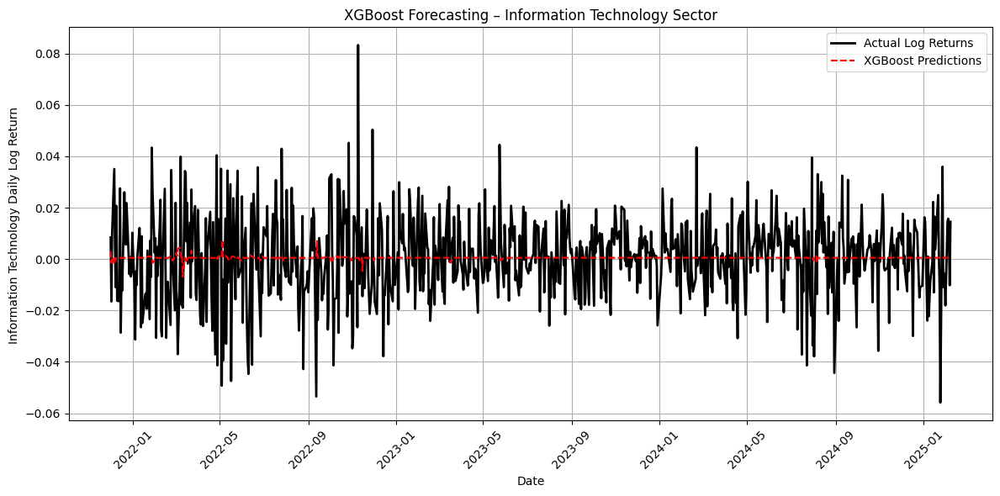

In [293]:
# ---------------------- PLOT RESULTS ----------------------
plt.figure(figsize=(12, 6))
plt.plot(data_forecast_model.index[train_size:], data_forecast_model[target_column].iloc[train_size:], label="Actual Log Returns", color="black", linewidth=2)
plt.plot(data_forecast_model.index[train_size:], xgb_predictions, label="XGBoost Predictions", linestyle="dashed", color="red")

plt.xticks(rotation=45)
plt.xlabel("Date")
plt.ylabel("Information Technology Daily Log Return ")
plt.title("XGBoost Forecasting – Information Technology Sector")
plt.legend()
plt.grid()
plt.tight_layout()
plt.show()

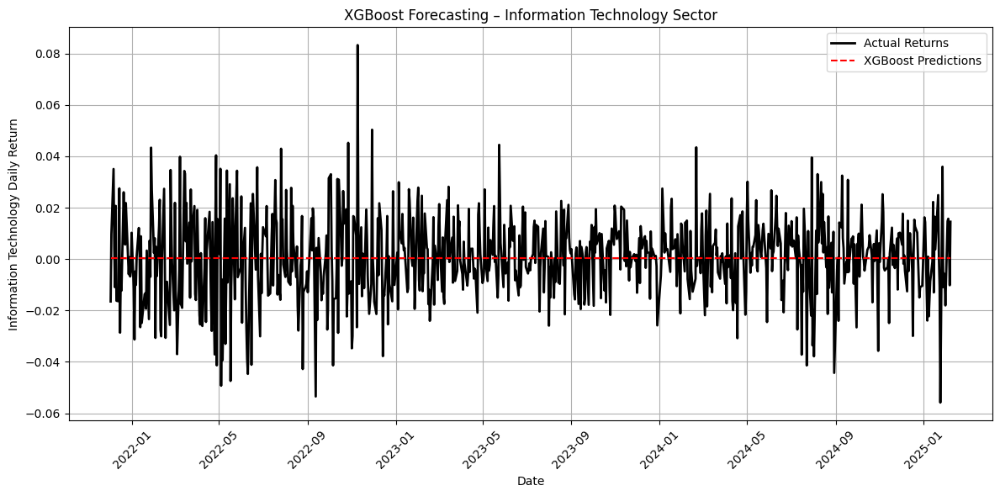

In [172]:
# plot same result, but after transforming log returns to normal returns
plt.figure(figsize=(12, 6))
plt.plot(data_forecast_model.index[train_size:], np.expm1(data_forecast_model[target_column].iloc[train_size:]), label="Actual Returns", color="black", linewidth=2)
plt.plot(data_forecast_model.index[train_size:], np.expm1(xgb_predictions), label="XGBoost Predictions", linestyle="dashed", color="red")
plt.xticks(rotation=45)
plt.xlabel("Date")
plt.ylabel("Information Technology Daily Return")
plt.title("XGBoost Forecasting – Information Technology Sector")
plt.legend()
plt.grid()
plt.tight_layout()
plt.show()

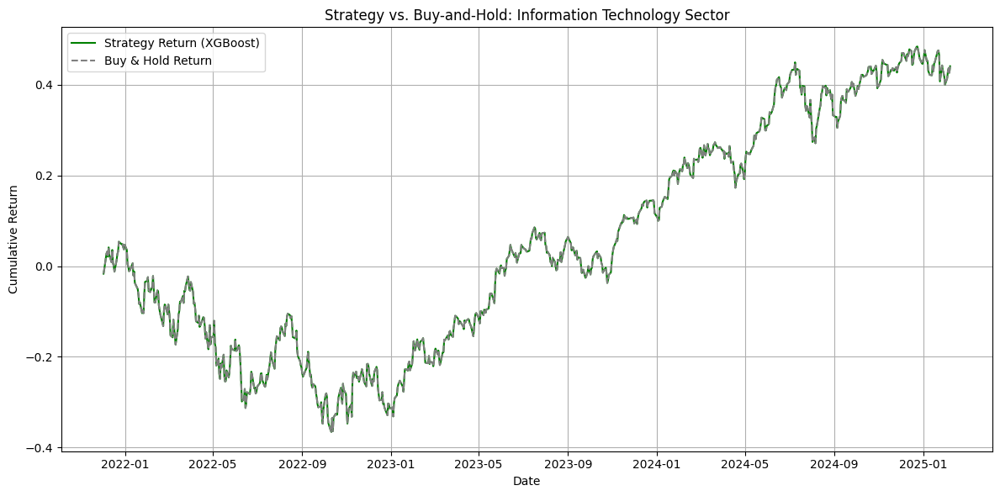

In [173]:
# ---------------------- STRATEGY SIMULATION ----------------------
signal = np.where(xgb_predictions > 0, 1, -1)
strategy_returns = signal * y_test.values
cumulative_strategy = np.cumsum(strategy_returns)
cumulative_bh = np.cumsum(y_test.values)

plt.figure(figsize=(12, 6))
plt.plot(y_test.index, cumulative_strategy, label="Strategy Return (XGBoost)", color="green")
plt.plot(y_test.index, cumulative_bh, label="Buy & Hold Return", color="gray", linestyle="--")
plt.xlabel("Date")
plt.ylabel("Cumulative Return")
plt.title("Strategy vs. Buy-and-Hold: Information Technology Sector")
plt.legend()
plt.grid(True)
plt.tight_layout()
plt.show()


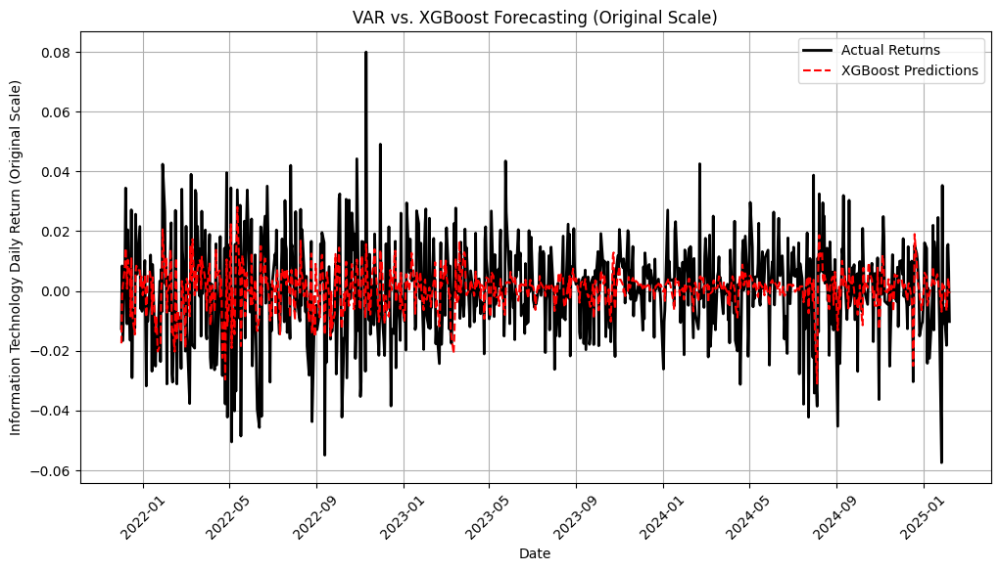

In [100]:
import matplotlib.pyplot as plt


plt.figure(figsize=(12, 6))

# Plot actual and predicted values using dates
plt.plot(data_forecast_model.index[train_size:], data_forecast_model[target_column].iloc[train_size:], label="Actual Returns", color="black", linewidth=2)
plt.plot(data_forecast_model.index[train_size:], xgb_predictions, label="XGBoost Predictions", linestyle="dashed", color="red")

# Format x-axis labels for better readability
plt.xticks(rotation=45)

plt.xlabel("Date")
plt.ylabel("Information Technology Daily Return (Original Scale)")
plt.title("VAR vs. XGBoost Forecasting (Original Scale)")
plt.legend()
plt.grid()

plt.show()


[I 2025-04-07 11:32:05,909] A new study created in memory with name: no-name-082b4137-f4da-4be0-8659-2a26d9b034a7


[I 2025-04-07 11:32:06,708] Trial 0 finished with value: 0.016444915683560334 and parameters: {'n_estimators': 101, 'learning_rate': 0.004999911773195497, 'max_depth': 7, 'subsample': 0.716701491637875, 'colsample_bytree': 0.6791602222613159, 'reg_alpha': 2.2605451572387194, 'reg_lambda': 2.30373940456708}. Best is trial 0 with value: 0.016444915683560334.
[I 2025-04-07 11:32:08,849] Trial 1 finished with value: 0.016122830297824593 and parameters: {'n_estimators': 156, 'learning_rate': 0.003908859354941995, 'max_depth': 6, 'subsample': 0.664085933472704, 'colsample_bytree': 0.6954829346252098, 'reg_alpha': 0.06572476611551803, 'reg_lambda': 1.862795179274973}. Best is trial 1 with value: 0.016122830297824593.
[I 2025-04-07 11:32:09,924] Trial 2 finished with value: 0.016472932167452648 and parameters: {'n_estimators': 271, 'learning_rate': 0.004995894702131928, 'max_depth': 5, 'subsample': 0.6291518138793631, 'colsample_bytree': 0.8948295157323918, 'reg_alpha': 9.48492466270609, 'reg_

Best Hyperparameters: {'n_estimators': 251, 'learning_rate': 0.03575176751155548, 'max_depth': 4, 'subsample': 0.9443937120003406, 'colsample_bytree': 0.9908701166773936, 'reg_alpha': 0.21005301953191044, 'reg_lambda': 4.0779169274885305}

XGBoost Model Metrics:
MAE: 0.0108
RMSE: 0.0141


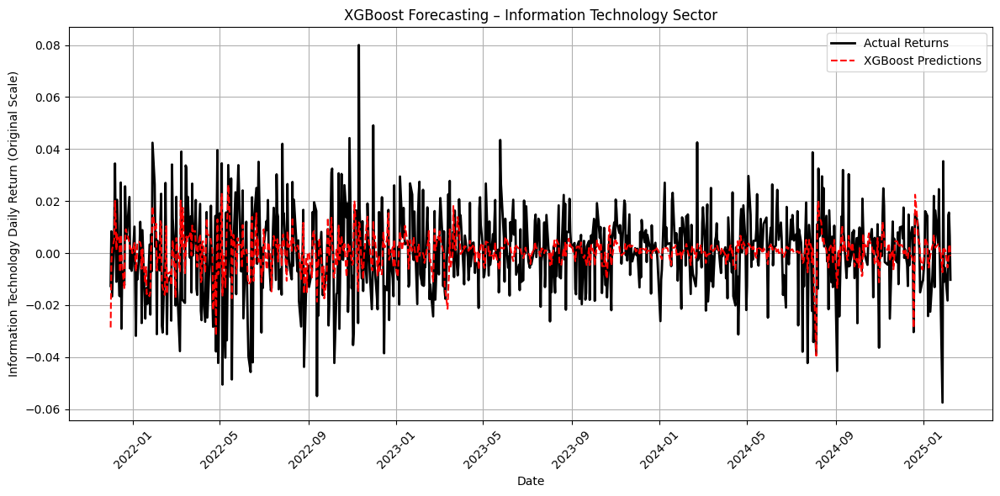

In [112]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from xgboost import XGBRegressor
from sklearn.metrics import mean_absolute_error, mean_squared_error
from sklearn.preprocessing import MinMaxScaler
from sklearn.model_selection import TimeSeriesSplit, cross_val_score
import optuna

# ---------------------- SETTINGS ----------------------
target_column = 'Information Technology Daily Log Return'
selected_features = important_features.tolist()

# ---------------------- DATA SPLIT ----------------------
train_size = int(0.9 * len(data_forecast_model))
train, test = data_forecast_model.iloc[:train_size], data_forecast_model.iloc[train_size:]

# ---------------------- SCALE FEATURES ----------------------
scaler = MinMaxScaler()
train_scaled = scaler.fit_transform(train[selected_features])
test_scaled = scaler.transform(test[selected_features])

train_scaled = pd.DataFrame(train_scaled, columns=selected_features, index=train.index)
test_scaled = pd.DataFrame(test_scaled, columns=selected_features, index=test.index)

train_scaled[target_column] = train[target_column]
test_scaled[target_column] = test[target_column]

# ---------------------- PREPARE FINAL DATA ----------------------
X_train, X_test = train_scaled[selected_features], test_scaled[selected_features]
y_train, y_test = train_scaled[target_column], test_scaled[target_column]

# ---------------------- OPTUNA HYPERPARAMETER TUNING ----------------------
ts_cv = TimeSeriesSplit(n_splits=5)

def objective(trial):
    params = {
        "n_estimators": trial.suggest_int("n_estimators", 50, 300),
        "learning_rate": trial.suggest_float("learning_rate", 0.001, 0.1, log=True),
        "max_depth": trial.suggest_int("max_depth", 3, 8),
        "subsample": trial.suggest_float("subsample", 0.6, 1.0),
        "colsample_bytree": trial.suggest_float("colsample_bytree", 0.6, 1.0),
        "reg_alpha": trial.suggest_float("reg_alpha", 0.0, 10.0),
        "reg_lambda": trial.suggest_float("reg_lambda", 0.0, 10.0),
    }

    model = XGBRegressor(**params, random_state=42)
    scores = cross_val_score(model, X_train, y_train, 
                             scoring='neg_root_mean_squared_error', 
                             cv=ts_cv)
    return -1 * np.mean(scores)

study = optuna.create_study(direction="minimize")
study.optimize(objective, n_trials=100)

best_params = study.best_params
print("Best Hyperparameters:", best_params)

# ---------------------- TRAIN FINAL MODEL WITH VALIDATION ----------------------
val_split = int(0.9 * len(X_train))
X_tr, X_val = X_train[:val_split], X_train[val_split:]
y_tr, y_val = y_train[:val_split], y_train[val_split:]

best_xgb_model = XGBRegressor(**best_params, random_state=42)
best_xgb_model.fit(X_tr, y_tr, 
                   eval_set=[(X_val, y_val)], 
                   verbose=False)

# ---------------------- PREDICT AND EVALUATE ----------------------
xgb_predictions = best_xgb_model.predict(X_test)

xgb_mae = mean_absolute_error(y_test, xgb_predictions)
xgb_rmse = np.sqrt(mean_squared_error(y_test, xgb_predictions))

print("\nXGBoost Model Metrics:")
print(f"MAE: {xgb_mae:.4f}")
print(f"RMSE: {xgb_rmse:.4f}")

# ---------------------- PLOT RESULTS ----------------------
plt.figure(figsize=(12, 6))
plt.plot(data_forecast_model.index[train_size:], data_forecast_model[target_column].iloc[train_size:], label="Actual Returns", color="black", linewidth=2)
plt.plot(data_forecast_model.index[train_size:], xgb_predictions, label="XGBoost Predictions", linestyle="dashed", color="red")

plt.xticks(rotation=45)
plt.xlabel("Date")
plt.ylabel("Information Technology Daily Return (Original Scale)")
plt.title("XGBoost Forecasting – Information Technology Sector")
plt.legend()
plt.grid()
plt.tight_layout()
plt.show()


#### TVP-VAR Forecasting